In [206]:
import pandas as pd 
import numpy as np
import folium
import math
import time
from scipy import stats
pd.options.mode.chained_assignment = None  # default='warn'
from plotnine import ggplot, aes, geom_line, geom_point, geom_bar, geom_boxplot
dataframe = pd.read_csv('/home/ruben/tmp/HH_intro_git_ds/precios_casas_sinduplicados.csv')
dataframe_orig = pd.read_csv('/home/ruben/Fundamentos-de-Analisis-de-DAtos-I/Practica/Melbourne_housing_FULL.csv')
import scipy.stats as ss
import matplotlib.pyplot as plot
import seaborn as sb
from seaborn import kdeplot
def quartile_skew(x):
  q = x.quantile([.25, .50, .75]) 
  return ((q[0.75] - q[0.5]) - (q[0.5] - q[0.25])) / (q[0.75] - q[0.25])


def mostrar_analisis_var_cuantitativas(data):
    #calcular coeficiente de variacion
 datos_variable=pd.DataFrame([{"coeficiente de Variacion":(data.std()/data.mean())*100,\
                 "rango de la variable":data.max() - data.min(),
                 "rango intercuartilico":data.quantile(0.75) - data.quantile(0.25),
                 "coeficiente de asimetria":quartile_skew(data),
                 "Min":data.min(),
                 "Max":data.max(),
                 "Mean":data.mean()}])
 return(datos_variable)

def mostrar_graf_variables_continuas(df_data,column):
    sb.set_theme(style="whitegrid")
    fig, (ax1,ax2) = plot.subplots(1,2,figsize=(12,6))
    sb.histplot(data=df_data,x=column,ax=ax1)
    sb.boxplot(data=df_data,x=column,ax=ax2)
    sb.displot(data=df_data, x=column,kind="kde",rug=True)
    return plot.show()
def mostrar_graf_variables_discretas(df_data,column):
    sb.set_theme(style="whitegrid")
    fig, (ax1,ax2) = plot.subplots(1,2,figsize=(12,6))
    sb.boxplot(data=df_data,x=column,ax=ax1)
    sb.countplot(data=df_data,x=column,ax=ax2)
    plot.show()

En primer lugar vamos a realizar una inspeccion ocular del dataset:


In [2]:

dataframe2016=dataframe[dataframe["Date"].str[-4:] =='2016']
dataframe2016.describe()
print("precio medio 2016 ",dataframe2016["Price"].mean())
dataframe2017=dataframe[dataframe["Date"].str[-4:] =='2017']
print("precio medio 2017 ",dataframe2017["Price"].mean())
dataframe2017.describe()
dataframe2018=dataframe[dataframe["Date"].str[-4:] =='2018']
print("precio medio 2018 ",dataframe2018["Price"].mean())
dataframe2017.describe()
dataframe.head()

precio medio 2016  1022499.8072289156
precio medio 2017  1003443.1982168043
precio medio 2018  970665.7519626565


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bathroom,Car,Landsize,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,783079.0,SS,Jellis,3/09/2016,2.5,3067.0,1.0,1.0,126.0,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,1.0,1.0,202.0,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,1.0,0.0,156.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,975391.0,VB,Rounds,4/02/2016,2.5,3067.0,2.0,1.0,0.0,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,2.0,0.0,134.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


Vemos que tenemos en total 21 variables algunas con aspecto de ser cualitativas y otras cuantitativas. En los proximos puntos iremos analizando las caracteristitcas de las mismas.
Vemos ne primer lugar el tipo de las variables:

In [3]:
dataframe.dtypes
len(dataframe["Suburb"].unique())

351

In [4]:
aux=pd.DataFrame({"Suburb":pd.value_counts(dataframe['Suburb']),"Method":pd.value_counts(dataframe['Method']),\
                  "Regionname":pd.value_counts(dataframe['Regionname']),"SellerG":pd.value_counts(dataframe['SellerG']),\
                 "Method":pd.value_counts(dataframe['Method']),"CouncilArea":pd.value_counts(dataframe['CouncilArea'])})
aux

,Suburb,Method,Regionname,SellerG,CouncilArea
@Realty,NaN,NaN,NaN,12.0,NaN
A,NaN,NaN,NaN,1.0,NaN
AIME,NaN,NaN,NaN,1.0,NaN
ASL,NaN,NaN,NaN,5.0,NaN
Abbotsford,137.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...
iProperty,NaN,NaN,NaN,1.0,NaN
iSell,NaN,NaN,NaN,32.0,NaN
iTRAK,NaN,NaN,NaN,33.0,NaN
viewbank,1.0,NaN,NaN,NaN,NaN


In [5]:
print(dataframe.describe())
aux=pd.DataFrame({"Suburb":dataframe["Suburb"].describe(),"CouncilArea":dataframe["CouncilArea"].describe(),\
                  "Regionname":dataframe["Regionname"].describe(),"SellerG":dataframe["SellerG"].describe(),\
                 "Method":dataframe["Method"].describe()})
aux

              Rooms         Price      Distance      Postcode      Bathroom  \
count  34857.000000  3.485700e+04  34856.000000  34856.000000  34857.000000   
mean       3.031012  1.004638e+06     11.184929   3116.062859      1.515879   
std        0.969933  6.018564e+05      6.788892    109.023903      0.710011   
min        1.000000  1.165300e+04      0.000000   3000.000000      0.000000   
25%        2.000000  6.181150e+05      6.400000   3051.000000      1.000000   
50%        3.000000  8.500000e+05     10.300000   3103.000000      1.000000   
75%        4.000000  1.231000e+06     14.000000   3156.000000      2.000000   
max       16.000000  1.120000e+07     48.100000   3978.000000     12.000000   

                Car       Landsize     Lattitude    Longtitude  Propertycount  
count  34857.000000   34857.000000  34857.000000  34857.000000   34854.000000  
mean       1.587257     511.352325    -29.984788    111.822439    7572.888306  
std        0.944052    2768.559242     14.502538

,Suburb,CouncilArea,Regionname,SellerG,Method
count,34857,34854,34854,34857,34857
unique,351,33,8,388,9
top,Reservoir,Boroondara City Council,Southern Metropolitan,Jellis,S
freq,844,3675,11836,3359,19744


## 4. Análisis y Transformación de Variables Cualitativas

para cada una de las variables cualitativas del dataframe comprobaremos sus medidas de centralidad y veremos cuales de ellas tiene sentido analizar



In [6]:
dataframe.describe()

,Rooms,Price,Distance,Postcode,Bathroom,Car,Landsize,Lattitude,Longtitude,Propertycount
count,34857.000000,3.485700e+04,34856.000000,34856.000000,34857.000000,34857.000000,34857.000000,34857.000000,34857.000000,34854.000000
mean,3.031012,1.004638e+06,11.184929,3116.062859,1.515879,1.587257,511.352325,-29.984788,111.822439,7572.888306
std,0.969933,6.018564e+05,6.788892,109.023903,0.710011,0.944052,2768.559242,14.502538,60.912399,4428.090313
min,1.000000,1.165300e+04,0.000000,3000.000000,0.000000,0.000000,-293.000000,-38.190430,0.000000,83.000000
25%,2.000000,6.181150e+05,6.400000,3051.000000,1.000000,1.000000,217.000000,-37.846900,144.726290,4385.000000
50%,3.000000,8.500000e+05,10.300000,3103.000000,1.000000,1.000000,412.000000,-37.776590,144.974100,6763.000000
75%,4.000000,1.231000e+06,14.000000,3156.000000,2.000000,2.000000,624.000000,-37.634990,145.051750,10412.000000
max,16.000000,1.120000e+07,48.100000,3978.000000,12.000000,26.000000,433014.000000,0.000000,145.526350,21650.000000


**Tabla 3.3.1**  
Antes de empezar el analisis de las variables indicar que el coeficiente de asimetria empleado es el de SKEWNESS por tanto para analizar los resultados podemos usar la sigueiente funcion.  
- Si el coeficiente de asimetría es menor que **-1 o mayor que 1**, la distribución de la variable es **extremadamente sesgada**.  
- Si el coeficiente de asimetría se encuentra entre **-1 y -0,5 o entre 0,5 y 1**, la distribución de la variable es **moderadamente sesgada**.  
- Si el coeficiente de asimetría se encuentra entre **-0,5 y 0,5**, la distribución de la variable es **aproximadamente sesgada**.  

### 4.3.1 Analisis de la variable Rooms

Esta variable contiene el número de habitaciones de cada propiedad que hay en la muesta. Como se puede ver en la tabla 3.3.1 la variable tiene valor en 34857 toma valores discretos en el rango 1 a 16 dormitorios, que es el máximo encontrado. La mitad de la muestra tiene tres habitaciones o menos y el 75% de pisos tienen entre 1 y 4 habitaciones.
A continuacion vamos a ver las frecuencias de la variable

In [7]:
pd.value_counts(dataframe['Rooms'])/dataframe["Rooms"].count()


3     0.432739
2     0.239034
4     0.228247
5     0.049832
1     0.042431
6     0.005852
7     0.000918
8     0.000545
10    0.000172
9     0.000115
12    0.000086
16    0.000029
Name: Rooms, dtype: float64

Como se puede ver mas de un 40% de los pisos vendidos tienen 3 dormitorios que es mas del doble del porcentaje del numero de pisos que tiene 2 dormitorios (un 23%) o 4 dormitorios(un 22,8%).

Pasamos a hacer el cálculo de las medidas de dispersión y simetria calcularemos el coficiente de variación, rango, IQR y simtetria:

In [8]:
mostrar_analisis_var_cuantitativas(dataframe["Rooms"])

,coeficiente de Variacion,rango de la variable,rango intercuartilico,coeficiente de asimetria,Min,Max,Mean
0,32.000296,15,2.0,0.0,1,16,3.031012


Como se puede var en la tabla anterio la variable tiene un coeficiente de variacion del 32% con un coeficiente de asimetria igual a 0 por que la variable es simetrica.



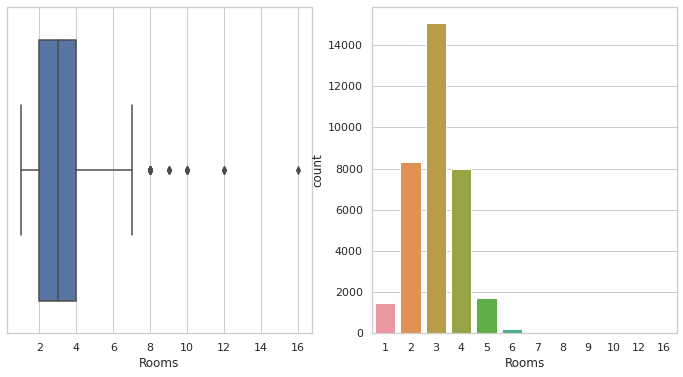

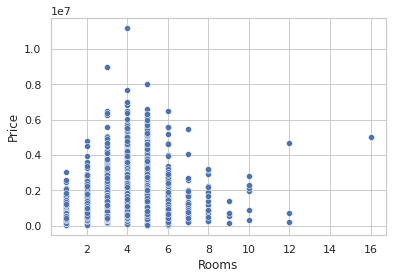

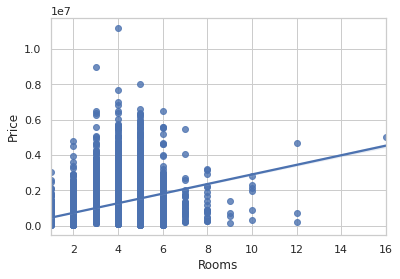

In [9]:
mostrar_graf_variables_discretas(dataframe,"Rooms")
dataframe["Rooms_TR"]=dataframe["Rooms"].apply(np.sqrt)
sb.scatterplot(data=dataframe, x="Rooms", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()
sb.regplot(x="Rooms", y="Price", data=dataframe);
plot.show()


Como ya se habia comprobado numéricamente la variable es muy simetrica aunque se aprecia unos outliers, viviendas de mas de 7 dormitorios que posteriormente veremos que efecto tienen en los modelos.  
A priori no parece necesario tratar de ningún modo esta variable por ser simétrica y los outliers no parecen ser error de muestra.

### 4.3.2 Analisis de la variable Bedroom2
Esta variable contiene el numero de dormitorios de cada propiedad. Como se puede ver en la tabla 3.3.1 la variable tiene valor en 26640 elementos de la muestra.Toma valores discretos en el rango 0 a 30 dormitorios, que es el máximo encontrado. La mitad de la muestra tiene tres dormitorios o menos y el 75% de pisos tienen entre 0 y 4 dormitorios. Estas cifras llaman la atencion ya que **el máximo numero de habitaciones de la variable rooms tenia como maximo 16**, por lo que esos datos puede que estén mal imputados.

In [11]:
pd.value_counts(dataframe['Bedroom2'])/dataframe["Bedroom2"].count()

KeyError: 'Bedroom2'

Los resultados son muy parecidos a los obtenidos con la variable Rooms por lo que no es probable que la variable rooms haga referencia tambien a numero de dormitorios y no solo de habitaciones. Como ya ocurria con la variable rooms casi el 89% de las propiedades tiene entre 2 y 4 dormitorios.
Vamos a verificar las medidas de dispersión y asimetria de la variable

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Bedroom2"])

El coeficiente de variacion es muy similar a la variable rooms y con el mismo rango intercuantilico, aunque en este caso el coficiente de asimetria es 0 lo que parece indica que se trata de una distribucion simétrica de los datos. Lo verificaremos con los siguientes diagramas:

In [ ]:
mostrar_graf_variables_discretas(dataframe,"Bedroom2")

como ya se habia comprobado numéricamente la variable es muy simetrica aunque se aprecia unos outliers, viviendas de mas de 7 dormitorios que se deberian eliminar. También habra que seleccionar que variable es de mejor calidad para llevar a cabo el modelo.

En este caso la variable tiene un coeficiente de asimetria 0 y algún outlier que veremos posteriormente como afecta al modelo 

### 4.3.3 Analisis de la variable Distance
La variable Distance indica la distancia al centro del inmbueble y toma como unidad las millas. Como se puede ver en la tabla 3.3.1 esta variable tiene valores en 34856 elementos de la muestra. La variable toma valores entre 0 y 48 millas , el 50% de los pisos de la muestra se encuentran a menos de 10,3 millas del centro de la ciudad y la desviacion tipica es 6,78. 
Calculamos medidas de dispersión y simetriía ya que las de centralidad las hemos visto en la tabla 3.3.1


In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Distance"])

segun el coeficiente la varibale parece bastante simetrica, vemaos el boxplot para cerciorarnos.
Vemos la distribucion de la variable y posibles outliers

In [ ]:
mostrar_graf_variables_continuas(dataframe,"Distance")

¿que se ve aqui?

como indica el coeficiente de asimetria , la variable es ligeramente asimetrica, vamos a intentar que se ajuste mejor a una distribucion normal

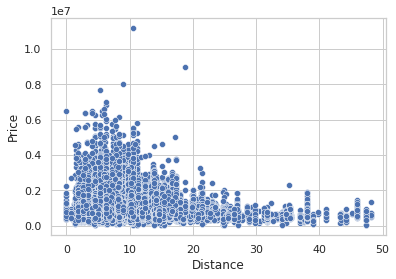

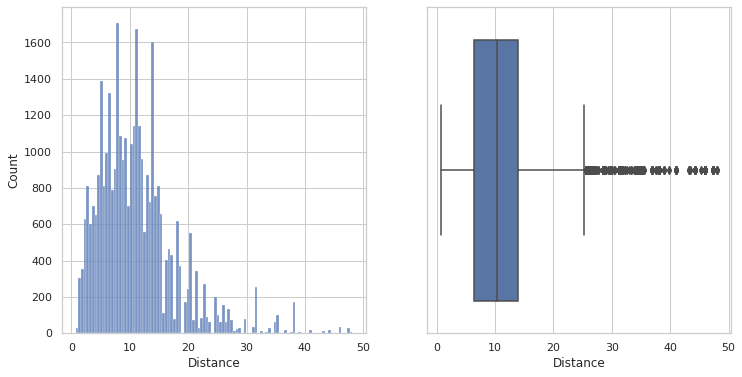

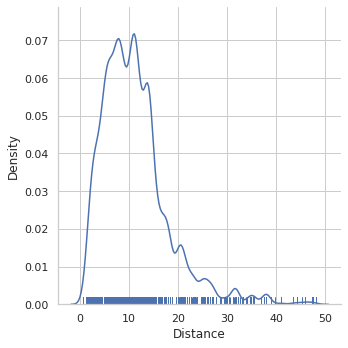

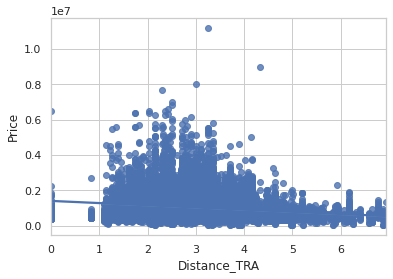

/home/ruben/anaconda3/lib/python3.7/site-packages/numpy/core/function_base.py:153: RuntimeWarning: invalid value encountered in multiply
/home/ruben/anaconda3/lib/python3.7/site-packages/numpy/linalg/linalg.py:1965: RuntimeWarning: invalid value encountered in greater


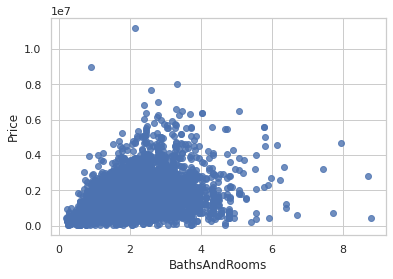

,Rooms,Price,Distance,Postcode,Bathroom,Car,Landsize,Lattitude,Longtitude,Propertycount,Rooms_TR,BathsAndRooms,Distance_TRA
Rooms,1.000000,0.437651,0.271511,0.085890,0.658195,0.458828,0.047956,-0.141514,0.128332,-0.071677,0.990772,0.529516,0.303786
Price,0.437651,1.000000,-0.215423,0.034814,0.417024,0.233005,0.038241,-0.114850,0.103752,-0.053696,0.438592,0.548326,-0.199581
Distance,0.271511,-0.215423,1.000000,0.481566,0.141792,0.246050,0.064098,-0.026576,0.021389,-0.018140,0.286191,-0.469538,0.975137
Postcode,0.085890,0.034814,0.481566,1.000000,0.113380,0.070404,0.042466,-0.019164,0.013918,0.017108,0.083589,-0.136952,0.409997
Bathroom,0.658195,0.417024,0.141792,0.113380,1.000000,0.420225,0.053903,-0.283318,0.270134,-0.051433,0.642804,0.599030,0.155922
Car,0.458828,0.233005,0.246050,0.070404,0.420225,1.000000,0.053259,-0.253169,0.244089,-0.028088,0.462041,0.178059,0.271195
Landsize,0.047956,0.038241,0.064098,0.042466,0.053903,0.053259,1.000000,-0.041225,0.040605,-0.022418,0.047700,0.021934,0.053085
Lattitude,-0.141514,-0.114850,-0.026576,-0.019164,-0.283318,-0.253169,-0.041225,1.000000,-0.990660,0.021103,-0.145084,-0.179138,-0.025643
Longtitude,0.128332,0.103752,0.021389,0.013918,0.270134,0.244089,0.040605,-0.990660,1.000000,-0.019837,0.131587,0.166804,0.021833
Propertycount,-0.071677,-0.053696,-0.018140,0.017108,-0.051433,-0.028088,-0.022418,0.021103,-0.019837,1.000000,-0.076877,-0.021583,-0.044839


In [12]:
#dataframe=dataframe[dataframe["Distance"].notna()] 

dataframe["BathsAndRooms"]=(dataframe["Rooms"]+dataframe["Bathroom"])/dataframe["Distance"].apply(np.sqrt)

dataframe_filtered=dataframe[dataframe["Distance"] >0]

dataframe_filtered.reset_index(drop=True,inplace=True)
sb.scatterplot(data=dataframe, x="Distance", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()
#dataframe_filtered["Distance_TRA"]=stats.boxcox(dataframe_filtered["Distance"])[0]

dataframe["Distance_TRA"]=dataframe["Distance"].apply(np.sqrt)


#sb.displot(data=dataframe_filtered, x="Distance_TRA",y="Price")
#plot.show()
#dataframe["Distance_SQR"]=dataframe["Distance"].apply(np.sqrt)
#sb.scatterplot(data=dataframe, x="Distance", y="Price")
#plot.show()
mostrar_graf_variables_continuas(dataframe_filtered,"Distance")
sb.regplot(x="Distance_TRA", y="Price", data=dataframe);
plot.show()
sb.regplot(x="BathsAndRooms", y="Price", data=dataframe);
plot.show()


dataframe.corr()

¿que hacemos con esto?

¿que hacemos con esto

### 4.3.4 Analisis de la variable Bathrooms

Esta variable indica el número de baños del inmuble.Como se puede ver en la tabla 3.3.1 la variable tiene valor en 26631 elementos de la muestra. Toma valores discretos en el rango 0 a 12 dormitorios. El 75% de pisos tienen entre 0 y 2 baños . A continuacion vamos a ver las frecuencias de la variable:

In [ ]:
pd.value_counts(dataframe['Bathroom'])/dataframe["Bathroom"].count()

Como se puede ver en la tabla anterior el 89% de la muestra tiene igual o menos de dos dormitorios comn una media de 1,6 baños. En la tabla 3.3.1 respecto a las medidas de dispersión podemos ver que la desviacion típica es de 0,72 y en la siguiente tabla vemos mas variables de dispersión y asimetria:

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Bathroom"])

El coeficiente de variación es del 44% y el coeficiente de asimetria es -1 lo que indica que la variable es moderadamente sesgada, tiene cola a la derecha. comprobaremos esto mismo de manera visual pintando su histograma y boxplot

In [ ]:
mostrar_graf_variables_discretas(dataframe,"Bathroom")

sb.regplot(x="Bathroom", y="Price", data=dataframe);
plot.show()

In [ ]:
sb.scatterplot(data=dataframe, x="Bathroom", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()

In [ ]:
dataframe_filtered=dataframe[(dataframe["Bathroom"]>0) & (dataframe["Bathroom"] is not None)]
dataframe["Bathroom_TRA"]=dataframe["Bathroom"].apply(np.sqrt)
dataframe["Price_TRA"]=dataframe["Price"].apply(np.sqrt)
dataframe["Price_TRA"]=np.log2(dataframe["Price"])
#dataframe["Distance_SQR"]=dataframe["Distance"].apply(np.sqrt)
sb.scatterplot(data=dataframe, x="Bathroom_TRA", y="Price")
mostrar_graf_variables_continuas(dataframe,"Bathroom_TRA")
plot.show()

sb.displot(data=dataframe, x="Bathroom_TRA",y="Price_TRA",kind="kde")
plot.show()
#dataframe["Distance_SQR"]=dataframe["Distance"].apply(np.sqrt)
#sb.scatterplot(data=dataframe, x="Distance", y="Price")
#plot.show()
mostrar_graf_variables_continuas(dataframe,"Bathroom_TRA")
sb.regplot(x="Bathroom_TRA", y="Price_TRA", data=dataframe);
plot.show()
#hola

NI idea de que hacer con esta variable si es que hay que hacer algo...

### 4.3.5 Analisis de la variable Car

Esta variable contiene el numero de plazas de aparcamiento que tiene asociadas la vivienda. Como se puede ver en la tabla 3.3.1 la variable tiene valor en 26129 de la muestra y toma valores discretos en el rango 0 a 26 plazas de aparcamiento. El 75% de pisos tienen entre 0 y 2 plazas de aparcamiento . A continuacion vamos a ver las frecuencias de la variable:


In [ ]:
pd.value_counts(dataframe['Car'])/dataframe["Car"].count()

como se puede ver casi el 47% de las casas de la muestra tienen dos plaza de aparcamiento y el 81% entre 1 y 2 plazas de aparcamiento.Respecto a las medidas de dispersión, en la tabla 3.3.1 podemos ver que la desviacion típica es de 1.01. En la siguiente tabla vemos mas variables de dispersión y asimetria:

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Car"])

como se puede ver hay un coeficiente de variación alto y asimetria por la izquierda que verificaremos mejor haciendo algunos diagramas

In [ ]:
mostrar_graf_variables_discretas(dataframe,"Car")

In [ ]:
sb.scatterplot(data=dataframe, x="Car", y="Price")
mostrar_graf_variables_continuas(dataframe,"Car")
plot.show()

### 4.3.6 Analisis de la variable Landsize

Esta variable contiene el tamaño del terreno asociado a la vivienda, excluye los metros de la vivienda y está calculada en metros cuadrados. La media de terreno asociado al inmbueble es de  593.598993  El 75% de pisos tienen menos de 670 metros cuadrados de parcela. A continuacion vamos a ver las frecuencias de la variable:

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Landsize"])

la variable es aproximadamente sesgada a la izquierda y con un rango de valores muy amplio.pintamos algunos gráficos para entender mejor la asimietria y la dispersión del a variablable

In [ ]:
mostrar_graf_variables_continuas(dataframe,"Landsize")

vamos a eliminar el registro superior que está desvirtuando el gráfico para poder analizarlo con mas detalle

In [ ]:
#Eliminamos outliers superiores para poder seguir analizando 
df_filtered=dataframe[dataframe["Landsize"]<20000]
print("registros filtrado = ",(dataframe["Landsize"].count()-df_filtered["Landsize"].count()))
mostrar_graf_variables_continuas(df_filtered,"Landsize")



sb.scatterplot(data=df_filtered, x="Landsize", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()

Continua habiendo outliers que hacen que la variabe sea muy dispersa por lo que la variable es clara condidata a ser transformada

In [ ]:
#dataframe=dataframe[dataframe["Distance"].notna()] 

dataframe_filtered=dataframe[(dataframe["Landsize"]>0) ]

#dataframe_filtered.reset_index(drop=True,inplace=True)

#dataframe_filtered["Landsize_TRA"]=stats.boxcox(dataframe_filtered["Distance"])[0]

#dataframe_filtered["Landsize_TRA"]=dataframe_filtered["Landsize"].apply(np.sqrt)
dataframe_filtered["Landsize_TRA"]=np.log(dataframe_filtered["Landsize"])



sb.scatterplot(data=dataframe_filtered, x="Landsize_TRA", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()
#dataframe_filtered['Landsize_TRA'] = np.where(dataframe['Landsize'] >= 40000, 40000, (dataframe['Landsize']//100)*100)
#dataframe_filtered['Landsize_TRA'] = np.where(dataframe_filtered['Landsize_TRA'] <= 70, 70, dataframe_filtered['Landsize_TRA'])


sb.displot(data=dataframe_filtered, x="Landsize_TRA",y="Price")
plot.show()
#dataframe["Distance_SQR"]=dataframe["Distance"].apply(np.sqrt)
#sb.scatterplot(data=dataframe, x="Distance", y="Price")
#plot.show()
mostrar_graf_variables_continuas(dataframe_filtered,"Landsize_TRA")


### 4.3.7 Analisis de la variable BulldingArea

Esta variable contiene el el tamaño del terreno asociado a la vivienda en metros cuadrados. Como se puede ver en la tabla 3.3.1 la variable tiene valor en 13742 elementos de la muestra.La media del tamaño de los inmubles de 160.25640 y toma valores continuos en el rango 0 a 44515 . El 75% de pisos tienen menos de 188.00000 metros cuadrado. A continuacion vamos a ver las medidas de dispersión de la varibale:

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["BuildingArea"])

como se puede ver la variable tiene asimetria a la derecha, pero en la tabla inicial vimos que la desviación estándar era muy alta para el valor que tomaba la media. Pasamos a comprobar visualmente la simetria

In [ ]:
mostrar_graf_variables_continuas(dataframe,"BuildingArea")

como se puede ver hay claramente algún outlier que desvirtua la muestra (ya lo pudimos ver tambien en la tabla 3.1.1 donde la media era de 522 y el maximo era mas de 44000 metros cuadrados de parcela).
Eliinamos el el maximo en cuestión y repiintamos los graficos

In [ ]:
#Eliminamos el maximo y vemos que ocurre
df_filtered=dataframe[dataframe["BuildingArea"]<1000]
print("registros filtrado = ",(dataframe["BuildingArea"].count()-df_filtered["BuildingArea"].count()))
mostrar_graf_variables_continuas(df_filtered,"BuildingArea")
#df_filtered["BuildingArea_TRA"]=np.log(dataframe_filtered["BuildingArea"])
df_filtered["BuildingArea_TRA"]=df_filtered["Distance"].apply(np.sqrt)
sb.scatterplot(data=df_filtered, x="BuildingArea_TRA", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()



df_filtered=dataframe[dataframe["YearBuilt"]>1800]

sb.scatterplot(data=df_filtered, x="YearBuilt", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()

Los datos sin ese registro tienen mejor aspecto y parecen muy concentrados. Lo tendremos en cuenta cuando tratemos la variables.

### 4.3.8 Analisis de la variable PropertyCountss

Esta variable contiene el numero de viviendas existentes en el barrio. Como se puede ver en la tabla 3.3.1 la variable tiene valor en 34854 y toma valores discretos en el rango 83 a 21650(que es el maximo de viviendas en un bbarrio). El 75% de pisos están en barrios con 10412 viviendas o menos.
A continuacion vamos a ver las frecuencias de la variable:

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Propertycount"])

La variable es aproximadamente sesgada a la derecha , lo comprobaremos visalmente:

In [ ]:
mostrar_graf_variables_continuas(dataframe,"Propertycount")

### 4.3.1 Analisis de la variable Latitud 

Esta variable contiene la coordenada geográfica correspondiente a la latitud del inmueble. Como se puede ver en la tabla de abajo

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Lattitude"])


In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Longtitude"])

In [207]:
import geopy.distance 
import geopandas
import numpy as np
from shapely.geometry import Point
from geopy.distance import distance
import geopy
from geopy.geocoders import Nominatim
# creamos el objeto geolocator

'''
geolocator = Nominatim(user_agent="Modelo-Melbourne")

#normalizamos las direcciones
dataframe["Address_normalized"]=dataframe["Address"].replace("/","") + str(", City of Melbourne") + ", " + dataframe["Postcode"].astype(str).str.slice(stop=4) + str(", Australia")
print(dataframe["Address_normalized"])
Loc=geolocator.geocode("217 Langridge St, City of Melbourne, 3067, Australia")

print(Loc)

def update_latitude(row):
  if ((row["Lattitude"]>-36.0) | (row["Lattitude"]<-38.0)) | ((row["Longtitude"]>146.0) | (row["Longtitude"]<144.0)):
    time.sleep(1)
    Loc=geolocator.geocode(row["Address_normalized"],timeout=None)
    if Loc != None:
        print(row["Address_normalized"])
        row["Lattitude"]=Loc.latitude
        row["Longtitude"]=Loc.longitude
        print(Loc.latitude, Loc.longitude)
        
dataframe.apply(update_latitude, axis=1)


for i,v in  dataframe.iterrows():
    if ((v["Lattitude"]>-36.0) | (v["Lattitude"]<-38.0)) | ((v["Longtitude"]>146.0) | (v["Longtitude"]<144.0)):
        print (v["Address_normalized"])
        Loc=geolocator.geocode(v["Address_normalized"],timeout=None)
        print(dataframe.loc[i]["Lattitude"], dataframe.loc[i]["Longtitude"])
        if Loc != None:
            dataframe.loc[i]["Lattitude"]=Loc.latitude
            dataframe.loc[i]["Longtitude"]=Loc.longitude
            print (v["Address_normalized"])
            print(Loc)
            time.sleep(1)
'''
mapa = folium.Map(location=[-37.810634, 145.001851], zoom_start=11)
data_filtered=dataframe[dataframe['Lattitude'].notnull() & \
                        dataframe['Longtitude'].notnull() &\
                       dataframe['Rooms'].notnull() & \
                       dataframe['Bathroom'].notnull() & \
                       dataframe['Price'].notnull()]
coords_2=(-37.810634,145.001851)



locations=data_filtered[['Lattitude', 'Longtitude']]
locations.round(6)
locationlist=locations.values.tolist()
len(locationlist)
for i,v in  data_filtered.iterrows():
    popup = popup = """
    Bathrooms: <b>%s</b><br>
    Rooms: <b>%s</b><br>
    Suburb : <b>%s</b><br>
    Price : <b>%s</b><br>
    """ % (v['Bathroom'], v['Rooms'], v['Suburb'], v['Price'])
    #print(v['Price'])
    if v['Price'] < float('500000.0'):
        #Color Azul
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#0000FF',
                            fill_color='#0000FF',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('500000.0')) & (v['Price'] < float('800000.0')):
        #color Verde
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#00FF40',
                            fill_color='#00FF40',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('800000.0')) & (v['Price'] < float('1200000.0')):
        #Color Amarillo
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#FFFF00',
                            fill_color='#FFFF00',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('1200000.0'))& (v['Price'] < float('1500000.0')):
        #Color cian
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#00fff7',
                            fill_color='#00fff7',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('1500000.0'))& (v['Price'] < float('1800000.0')):
        #Color Rojo
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#ff2300',
                            fill_color='#ff2300',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('1800000.0'))& (v['Price'] < float('2100000.0')):
        #Color Naranja
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#ffc900',
                            fill_color='#ffc900',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('2100000.0')):
        #Color Morado
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#f700ff',
                            fill_color='#f700ff',
                            fill=True, radius=1 ).add_to(mapa)
folium.Marker(location=('37.84280999999999','145.03483'), tooltip=popup,
                            color='#f711ff',
                            fill_color='#ffffff',
                            fill=True, radius=20 ).add_to(mapa)
mapa  

-37.7925704 144.9346231


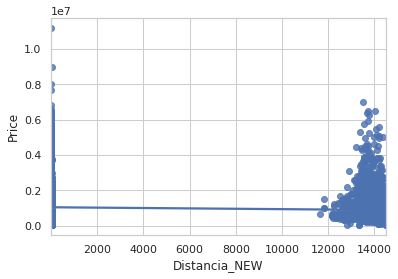

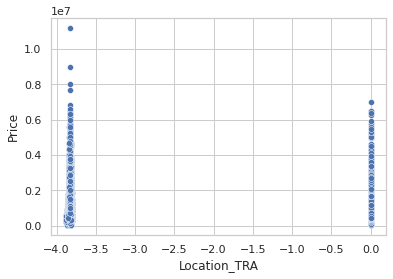

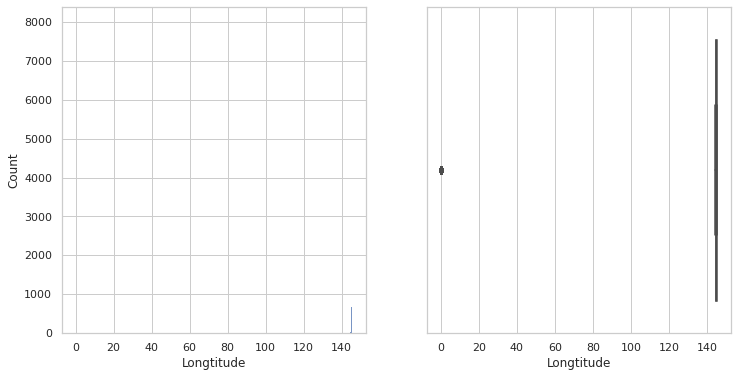

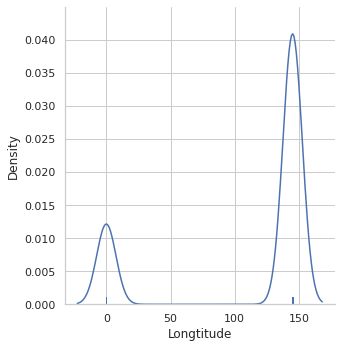

ValueError: Could not interpret value `Price_TRA` for parameter `y`

In [157]:
arr=[]
for lat, lon in zip(data_filtered['Lattitude'], data_filtered['Longtitude']):
    arr.append(distance((lat,lon), coords_2).km)

data_filtered["Distancia_NEW"]=arr
dataframe.describe()

#df_fil=dataframe[(dataframe["Lattitude"] is not None) & (dataframe["Longtitude"] is not None)]
dataframe["Location_TRA"]=dataframe.Longtitude/dataframe.Lattitude
dataframe_less=dataframe[(dataframe["Lattitude"]>=dataframe["Lattitude"].mean()) ]
dataframe_over=dataframe[(dataframe["Lattitude"]<dataframe["Lattitude"].mean()) ]

sb.regplot(data=data_filtered, x="Distancia_NEW", y="Price")
plot.show()
#mostrar_graf_variables_continuas(dataframe,"Location_TRA")
sb.scatterplot(data=dataframe, x="Location_TRA", y="Price")
mostrar_graf_variables_continuas(dataframe,"Longtitude")
plot.show()

dataframe_min=dataframe[dataframe["Lattitude"]>=dataframe["Lattitude"].mean()]
#dataframe["Lattitude_TRA"]=np.log(dataframe["Lattitude"])
#dataframe["Price_TRA"]=np.log(dataframe["Price"])
#mostrar_graf_variables_continuas(dataframe,"Location_TRA")
sb.scatterplot(data=dataframe, x="Lattitude", y="Price_TRA")
mostrar_graf_variables_continuas(dataframe,"Lattitude_TRA")
plot.show()

sb.scatterplot(data=dataframe, x="Lattitude_TRA", y="Price_TRA")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()

data_filtered.corr()

#sb.swarmplot(data=dataframe, x="Lattitude", y="Longtitude",hue="Price",s = 4)
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
#plot.show()x_estimator=np.mean

#sb.lmplot(x="Location_TRA", y="Price", data=dataframe, x_estimator=np.mean);
#plot.show()

           Suburb             Address  Rooms Type      Price Method  \
0      Abbotsford       68 Studley St      2    h        NaN     SS   
1      Abbotsford        85 Turner St      2    h  1480000.0      S   
2      Abbotsford     25 Bloomburg St      2    h  1035000.0      S   
3      Abbotsford  18/659 Victoria St      3    u        NaN     VB   
4      Abbotsford        5 Charles St      3    h  1465000.0     SP   
...           ...                 ...    ...  ...        ...    ...   
34852  Yarraville         13 Burns St      4    h  1480000.0     PI   
34853  Yarraville       29A Murray St      2    h   888000.0     SP   
34854  Yarraville      147A Severn St      2    t   705000.0      S   
34855  Yarraville    12/37 Stephen St      3    h  1140000.0     SP   
34856  Yarraville    3 Tarrengower St      2    h  1020000.0     PI   

             SellerG        Date  Distance  Postcode  ...  Bathroom  Car  \
0             Jellis   3/09/2016       2.5    3067.0  ...       1.0  1.

-37.84256166666666 145.03477999999998
7.695881985503274
-37.84256166666666 145.03477999999998
6.780222795601122
-37.84256166666666 145.03477999999998
7.102739013554724
-37.84256166666666 145.03477999999998
7.071302292446527
-37.84256166666666 145.03477999999998
7.0574457666329815
-37.84256166666666 145.03477999999998
7.309629446609428
-37.84256166666666 145.03477999999998
7.64899549911605
-37.84256166666666 145.03477999999998
7.138222528718761
-37.84256166666666 145.03477999999998
7.226378891128293
-37.84256166666666 145.03477999999998
7.312895673773248
-37.84256166666666 145.03477999999998
6.974926594515234
-37.84256166666666 145.03477999999998
7.32247532959509
-37.84256166666666 145.03477999999998
7.524017627785586
-37.84256166666666 145.03477999999998
6.71524016673836
-37.84256166666666 145.03477999999998
7.463704559698457
-37.84256166666666 145.03477999999998
7.506871344584988
-37.84256166666666 145.03477999999998
13985.00306114124
-37.84256166666666 145.03477999999998
7.5687528606

-37.84256166666666 145.03477999999998
12.873251865706516
-37.84256166666666 145.03477999999998
13.33360050472019
-37.84256166666666 145.03477999999998
13.368616231277933
-37.84256166666666 145.03477999999998
12.83479748905212
-37.84256166666666 145.03477999999998
12.891791439909355
-37.84256166666666 145.03477999999998
13.385312493582791
-37.84256166666666 145.03477999999998
13518.879351993693
-37.84256166666666 145.03477999999998
11.972284915114345
-37.84256166666666 145.03477999999998
12.489226169336995
-37.84256166666666 145.03477999999998
13.246971681643993
-37.84256166666666 145.03477999999998
13.799468886384544
-37.84256166666666 145.03477999999998
11.5860060859704
-37.84256166666666 145.03477999999998
12.670423990369224
-37.84256166666666 145.03477999999998
12.143778779614316
-37.84256166666666 145.03477999999998
13.751356130115523
-37.84256166666666 145.03477999999998
12.756151251503878
-37.84256166666666 145.03477999999998
13.157808083942827
-37.84256166666666 145.034779999999

14399.386953792167
-37.84256166666666 145.03477999999998
14492.822795661476
-37.84256166666666 145.03477999999998
7.0597102767373165
-37.84256166666666 145.03477999999998
6.35399327410439
-37.84256166666666 145.03477999999998
6.4837339267655345
-37.84256166666666 145.03477999999998
6.356108034716727
-37.84256166666666 145.03477999999998
6.925595325806217
-37.84256166666666 145.03477999999998
6.2562253106867685
-37.84256166666666 145.03477999999998
7.3103366795254185
-37.84256166666666 145.03477999999998
5.862878514616485
-37.84256166666666 145.03477999999998
14382.566837176086
-37.84256166666666 145.03477999999998
16.920845239523686
-37.84256166666666 145.03477999999998
17.639482435377317
-37.84256166666666 145.03477999999998
17.59028405827227
-37.84256166666666 145.03477999999998
17.04257995525715
-37.84256166666666 145.03477999999998
17.11433485912482
-37.84256166666666 145.03477999999998
17.574270012276468
-37.84256166666666 145.03477999999998
17.19273422540438
-37.84256166666666 14

-37.84256166666666 145.03477999999998
5.665943931859383
-37.84256166666666 145.03477999999998
14448.496901077182
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
4.786189240077065
-37.84256166666666 145.03477999999998
6.6425119995296145
-37.84256166666666 145.03477999999998
5.087109113229223
-37.84256166666666 145.03477999999998
5.53527094457462
-37.84256166666666 145.03477999999998
14082.360411829191
-37.84256166666666 145.03477999999998
13838.945501813285
-37.84256166666666 145.03477999999998
5.651262187658165
-37.84256166666666 145.03477999999998
5.5917141672357
-37.84256166666666 145.03477999999998
5.186247712499369
-37.84256166666666 145.03477999999998
5.284222600307111
-37.84256166666666 145.03477999999998
5.792644516298617
-37.84256166666666 145.03477999999998
5.351351550591818
-37.84256166666666 145.03477999999998
4.751066549630782
-37.84256166666666 145.03477999999998
5.016721258021845
-37.84256166666666 145.03477999999998
5.654871

6.964289157904331
-37.84256166666666 145.03477999999998
8.253629747207043
-37.84256166666666 145.03477999999998
5.885119374279366
-37.84256166666666 145.03477999999998
7.354446118500704
-37.84256166666666 145.03477999999998
6.1312227763719225
-37.84256166666666 145.03477999999998
7.2423446070630755
-37.84256166666666 145.03477999999998
8.396659427167897
-37.84256166666666 145.03477999999998
6.997514836310484
-37.84256166666666 145.03477999999998
8.110043949839666
-37.84256166666666 145.03477999999998
7.407789053532888
-37.84256166666666 145.03477999999998
14138.161673651188
-37.84256166666666 145.03477999999998
7.680313301068019
-37.84256166666666 145.03477999999998
6.016725171830413
-37.84256166666666 145.03477999999998
6.148212286935385
-37.84256166666666 145.03477999999998
6.748195213536245
-37.84256166666666 145.03477999999998
12408.82977267575
-37.84256166666666 145.03477999999998
7.190053997304446
-37.84256166666666 145.03477999999998
7.410237775972732
-37.84256166666666 145.0347

-37.84256166666666 145.03477999999998
8.72097363625449
-37.84256166666666 145.03477999999998
8.84291919516357
-37.84256166666666 145.03477999999998
8.919069400662613
-37.84256166666666 145.03477999999998
9.105028709720525
-37.84256166666666 145.03477999999998
14463.970371986623
-37.84256166666666 145.03477999999998
9.25107561075664
-37.84256166666666 145.03477999999998
9.119309795223542
-37.84256166666666 145.03477999999998
14491.640702780269
-37.84256166666666 145.03477999999998
14415.940729202752
-37.84256166666666 145.03477999999998
14085.113066370548
-37.84256166666666 145.03477999999998
8.656435865927262
-37.84256166666666 145.03477999999998
8.946693941079873
-37.84256166666666 145.03477999999998
9.031995964932648
-37.84256166666666 145.03477999999998
10.325926011032962
-37.84256166666666 145.03477999999998
10.12771101901808
-37.84256166666666 145.03477999999998
8.772758752554545
-37.84256166666666 145.03477999999998
9.048088941163718
-37.84256166666666 145.03477999999998
9.749035

16.374693759461568
-37.84256166666666 145.03477999999998
14172.43428905026
-37.84256166666666 145.03477999999998
14454.222418210062
-37.84256166666666 145.03477999999998
14182.595856212047
-37.84256166666666 145.03477999999998
17.004600270318104
-37.84256166666666 145.03477999999998
17.033203610682744
-37.84256166666666 145.03477999999998
17.512138492155703
-37.84256166666666 145.03477999999998
17.220496139959465
-37.84256166666666 145.03477999999998
17.217603184952992
-37.84256166666666 145.03477999999998
14411.319911555207
-37.84256166666666 145.03477999999998
17.436086897195928
-37.84256166666666 145.03477999999998
14442.404106934526
-37.84256166666666 145.03477999999998
17.91416462578544
-37.84256166666666 145.03477999999998
14189.65903819587
-37.84256166666666 145.03477999999998
17.60417127512208
-37.84256166666666 145.03477999999998
17.333801736789283
-37.84256166666666 145.03477999999998
14458.729518673717
-37.84256166666666 145.03477999999998
17.37915633376851
-37.8425616666666

-37.84256166666666 145.03477999999998
8.42394726023908
-37.84256166666666 145.03477999999998
9.260092911637832
-37.84256166666666 145.03477999999998
8.417075455766684
-37.84256166666666 145.03477999999998
8.719215758787042
-37.84256166666666 145.03477999999998
9.401655680120703
-37.84256166666666 145.03477999999998
7.9946692676165725
-37.84256166666666 145.03477999999998
8.532321141347246
-37.84256166666666 145.03477999999998
9.399088546520616
-37.84256166666666 145.03477999999998
9.049995130212986
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
7.392331541956714
-37.84256166666666 145.03477999999998
8.916873904983353
-37.84256166666666 145.03477999999998
9.943000942269034
-37.84256166666666 145.03477999999998
14226.780886800983
-37.84256166666666 145.03477999999998
14191.589815771475
-37.84256166666666 145.03477999999998
9.740637392038483
-37.84256166666666 145.03477999999998
9.787859666723367
-37.84256166666666 145.03477999999998
9.38355

13433.901542338679
-37.84256166666666 145.03477999999998
11.620853784430338
-37.84256166666666 145.03477999999998
10.289178678527703
-37.84256166666666 145.03477999999998
10.918656139096663
-37.84256166666666 145.03477999999998
13858.914012792546
-37.84256166666666 145.03477999999998
9.28931197887567
-37.84256166666666 145.03477999999998
14328.059196043205
-37.84256166666666 145.03477999999998
10.875378998425289
-37.84256166666666 145.03477999999998
10.949275740498589
-37.84256166666666 145.03477999999998
12845.090978980892
-37.84256166666666 145.03477999999998
10.26841825211943
-37.84256166666666 145.03477999999998
10.250828746723109
-37.84256166666666 145.03477999999998
11.395287118076666
-37.84256166666666 145.03477999999998
11.398513169269526
-37.84256166666666 145.03477999999998
11.14766313339682
-37.84256166666666 145.03477999999998
10.78920460432604
-37.84256166666666 145.03477999999998
10.136942770618912
-37.84256166666666 145.03477999999998
10.332828493829359
-37.8425616666666

-37.84256166666666 145.03477999999998
5.518173406754143
-37.84256166666666 145.03477999999998
14499.144306770077
-37.84256166666666 145.03477999999998
5.917048648523058
-37.84256166666666 145.03477999999998
14495.776697588548
-37.84256166666666 145.03477999999998
6.870367615016192
-37.84256166666666 145.03477999999998
14499.144306770077
-37.84256166666666 145.03477999999998
14492.394900316662
-37.84256166666666 145.03477999999998
6.972561595038438
-37.84256166666666 145.03477999999998
8.336279210336594
-37.84256166666666 145.03477999999998
5.6106575489632355
-37.84256166666666 145.03477999999998
5.612112126985716
-37.84256166666666 145.03477999999998
7.295530864381598
-37.84256166666666 145.03477999999998
13925.759988257827
-37.84256166666666 145.03477999999998
14499.144306770077
-37.84256166666666 145.03477999999998
7.384230560512244
-37.84256166666666 145.03477999999998
14460.728346279448
-37.84256166666666 145.03477999999998
7.21696439584046
-37.84256166666666 145.03477999999998
144

-37.84256166666666 145.03477999999998
14284.266969116456
-37.84256166666666 145.03477999999998
13664.588797157945
-37.84256166666666 145.03477999999998
14475.512901906211
-37.84256166666666 145.03477999999998
13897.878005092143
-37.84256166666666 145.03477999999998
3.1672476142512545
-37.84256166666666 145.03477999999998
3.5817545405045537
-37.84256166666666 145.03477999999998
13335.770442031093
-37.84256166666666 145.03477999999998
3.9316802567710303
-37.84256166666666 145.03477999999998
5.058157224146877
-37.84256166666666 145.03477999999998
3.17727135550992
-37.84256166666666 145.03477999999998
14030.18629039633
-37.84256166666666 145.03477999999998
3.0042386489587294
-37.84256166666666 145.03477999999998
4.378282848936469
-37.84256166666666 145.03477999999998
4.908423499628939
-37.84256166666666 145.03477999999998
14485.640438853308
-37.84256166666666 145.03477999999998
2.4255820570527318
-37.84256166666666 145.03477999999998
2.789240104519858
-37.84256166666666 145.03477999999998


-37.84256166666666 145.03477999999998
6.163197333621767
-37.84256166666666 145.03477999999998
6.298579908386037
-37.84256166666666 145.03477999999998
5.932416840964012
-37.84256166666666 145.03477999999998
6.497207416541041
-37.84256166666666 145.03477999999998
6.510673304037872
-37.84256166666666 145.03477999999998
6.023865870059125
-37.84256166666666 145.03477999999998
5.3888179481251175
-37.84256166666666 145.03477999999998
5.386491165248865
-37.84256166666666 145.03477999999998
6.907853696899952
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
5.586887883744202
-37.84256166666666 145.03477999999998
5.170494081303412
-37.84256166666666 145.03477999999998
5.343218834179247
-37.84256166666666 145.03477999999998
6.145115002323371
-37.84256166666666 145.03477999999998
6.287148025265997
-37.84256166666666 145.03477999999998
6.494137281697246
-37.84256166666666 145.03477999999998
6.322453726313336
-37.84256166666666 145.03477999999998
6.652290

13600.176281450298
-37.84256166666666 145.03477999999998
7.052859344846623
-37.84256166666666 145.03477999999998
14431.648693065898
-37.84256166666666 145.03477999999998
6.870606334424564
-37.84256166666666 145.03477999999998
6.620460170758325
-37.84256166666666 145.03477999999998
6.318438424585931
-37.84256166666666 145.03477999999998
6.665287828454785
-37.84256166666666 145.03477999999998
6.615477978423582
-37.84256166666666 145.03477999999998
6.415486381487862
-37.84256166666666 145.03477999999998
7.04513417083623
-37.84256166666666 145.03477999999998
6.371650564153145
-37.84256166666666 145.03477999999998
6.407739625899426
-37.84256166666666 145.03477999999998
6.949549717813594
-37.84256166666666 145.03477999999998
6.651297592749388
-37.84256166666666 145.03477999999998
6.542928435282306
-37.84256166666666 145.03477999999998
6.34575997932149
-37.84256166666666 145.03477999999998
6.613720633859507
-37.84256166666666 145.03477999999998
6.585037363167462
-37.84256166666666 145.0347799

-37.84256166666666 145.03477999999998
11.496074094162054
-37.84256166666666 145.03477999999998
13.537515932951237
-37.84256166666666 145.03477999999998
12.644635344321824
-37.84256166666666 145.03477999999998
13.784046378597195
-37.84256166666666 145.03477999999998
13.294241668254523
-37.84256166666666 145.03477999999998
12.315973192972914
-37.84256166666666 145.03477999999998
12.40263688201877
-37.84256166666666 145.03477999999998
12.153406123454287
-37.84256166666666 145.03477999999998
12.392331544003738
-37.84256166666666 145.03477999999998
13.449401329431062
-37.84256166666666 145.03477999999998
11.516610884219388
-37.84256166666666 145.03477999999998
13.360087994658807
-37.84256166666666 145.03477999999998
12.558025655875603
-37.84256166666666 145.03477999999998
11.819623172501073
-37.84256166666666 145.03477999999998
13.058215323250687
-37.84256166666666 145.03477999999998
12.964775065667173
-37.84256166666666 145.03477999999998
12.877210561448894
-37.84256166666666 145.034779999

10.522283261499139
-37.84256166666666 145.03477999999998
9.080359575981886
-37.84256166666666 145.03477999999998
11.36800236595722
-37.84256166666666 145.03477999999998
9.135087667215409
-37.84256166666666 145.03477999999998
10.062734558197443
-37.84256166666666 145.03477999999998
10.437216890779153
-37.84256166666666 145.03477999999998
14072.896750891898
-37.84256166666666 145.03477999999998
9.327724150696659
-37.84256166666666 145.03477999999998
11.29383427830317
-37.84256166666666 145.03477999999998
8.817785047329131
-37.84256166666666 145.03477999999998
8.99074406081237
-37.84256166666666 145.03477999999998
14107.759689133776
-37.84256166666666 145.03477999999998
8.752470523993788
-37.84256166666666 145.03477999999998
10.84949570477462
-37.84256166666666 145.03477999999998
10.363739028865801
-37.84256166666666 145.03477999999998
10.414856941817998
-37.84256166666666 145.03477999999998
11.246454016267345
-37.84256166666666 145.03477999999998
14460.366487217438
-37.84256166666666 145

6.249017193853933
-37.84256166666666 145.03477999999998
6.132108085460134
-37.84256166666666 145.03477999999998
5.347387511801113
-37.84256166666666 145.03477999999998
6.125099243586907
-37.84256166666666 145.03477999999998
5.442931070573407
-37.84256166666666 145.03477999999998
5.826524049685601
-37.84256166666666 145.03477999999998
6.160108395050781
-37.84256166666666 145.03477999999998
5.961851404170908
-37.84256166666666 145.03477999999998
14271.291278908151
-37.84256166666666 145.03477999999998
5.347387511801113
-37.84256166666666 145.03477999999998
6.173491787061857
-37.84256166666666 145.03477999999998
14236.482176047575
-37.84256166666666 145.03477999999998
5.243856279274804
-37.84256166666666 145.03477999999998
5.526928625888364
-37.84256166666666 145.03477999999998
13612.300431542204
-37.84256166666666 145.03477999999998
5.832588568340776
-37.84256166666666 145.03477999999998
13945.381262168614
-37.84256166666666 145.03477999999998
5.513974893535953
-37.84256166666666 145.034

-37.84256166666666 145.03477999999998
7.255190055549465
-37.84256166666666 145.03477999999998
6.84912448408672
-37.84256166666666 145.03477999999998
7.632556258125334
-37.84256166666666 145.03477999999998
7.191039754943051
-37.84256166666666 145.03477999999998
8.20538512379387
-37.84256166666666 145.03477999999998
13863.501201669096
-37.84256166666666 145.03477999999998
8.3131211083253
-37.84256166666666 145.03477999999998
7.787166361665387
-37.84256166666666 145.03477999999998
7.592067636523906
-37.84256166666666 145.03477999999998
8.099340545013051
-37.84256166666666 145.03477999999998
6.789817863962379
-37.84256166666666 145.03477999999998
8.57835222577294
-37.84256166666666 145.03477999999998
14156.800101698389
-37.84256166666666 145.03477999999998
7.9575300137048455
-37.84256166666666 145.03477999999998
7.95150139989668
-37.84256166666666 145.03477999999998
7.3286533062984445
-37.84256166666666 145.03477999999998
6.941810889554661
-37.84256166666666 145.03477999999998
8.4928444975

-37.84256166666666 145.03477999999998
14.14101416042114
-37.84256166666666 145.03477999999998
14.205360152897159
-37.84256166666666 145.03477999999998
13.790155977157719
-37.84256166666666 145.03477999999998
13.751308530632178
-37.84256166666666 145.03477999999998
12.545226251752107
-37.84256166666666 145.03477999999998
13.89878988647819
-37.84256166666666 145.03477999999998
12.314742377184777
-37.84256166666666 145.03477999999998
14324.961537683226
-37.84256166666666 145.03477999999998
12.936584039124604
-37.84256166666666 145.03477999999998
14.477995336827462
-37.84256166666666 145.03477999999998
13.836798570942436
-37.84256166666666 145.03477999999998
14.368822922389572
-37.84256166666666 145.03477999999998
13.784504038120417
-37.84256166666666 145.03477999999998
13591.289603950569
-37.84256166666666 145.03477999999998
12.461327702348003
-37.84256166666666 145.03477999999998
13.47061442921017
-37.84256166666666 145.03477999999998
13.767183394151662
-37.84256166666666 145.03477999999

-37.84256166666666 145.03477999999998
2.201671324967532
-37.84256166666666 145.03477999999998
5.161281526610315
-37.84256166666666 145.03477999999998
2.006607124058819
-37.84256166666666 145.03477999999998
5.1502553033220035
-37.84256166666666 145.03477999999998
1.617382788141402
-37.84256166666666 145.03477999999998
3.4902958376967277
-37.84256166666666 145.03477999999998
1.2442028857785314
-37.84256166666666 145.03477999999998
2.5163610447966027
-37.84256166666666 145.03477999999998
2.132973519706425
-37.84256166666666 145.03477999999998
4.567664921199665
-37.84256166666666 145.03477999999998
2.8914610370914677
-37.84256166666666 145.03477999999998
1.307697075279761
-37.84256166666666 145.03477999999998
3.036581600751641
-37.84256166666666 145.03477999999998
2.445666849210799
-37.84256166666666 145.03477999999998
3.3776963857400344
-37.84256166666666 145.03477999999998
2.492666227072056
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
142

-37.84256166666666 145.03477999999998
16.34315141076774
-37.84256166666666 145.03477999999998
14251.313359968926
-37.84256166666666 145.03477999999998
14204.97201137989
-37.84256166666666 145.03477999999998
17.161200731749894
-37.84256166666666 145.03477999999998
16.442663820502833
-37.84256166666666 145.03477999999998
16.298432372722477
-37.84256166666666 145.03477999999998
16.12543736844394
-37.84256166666666 145.03477999999998
16.985003716371764
-37.84256166666666 145.03477999999998
16.76769793540579
-37.84256166666666 145.03477999999998
16.57744857242369
-37.84256166666666 145.03477999999998
14485.705546931506
-37.84256166666666 145.03477999999998
16.625536255306727
-37.84256166666666 145.03477999999998
17.022387650673785
-37.84256166666666 145.03477999999998
16.687712520159106
-37.84256166666666 145.03477999999998
16.68882261696812
-37.84256166666666 145.03477999999998
17.01482456977137
-37.84256166666666 145.03477999999998
16.938873014444606
-37.84256166666666 145.03477999999998


-37.84256166666666 145.03477999999998
3.167393069632414
-37.84256166666666 145.03477999999998
2.8462680684259825
-37.84256166666666 145.03477999999998
3.2589750721823165
-37.84256166666666 145.03477999999998
1.5346815155410125
-37.84256166666666 145.03477999999998
1.4178777655570665
-37.84256166666666 145.03477999999998
13943.28015441197
-37.84256166666666 145.03477999999998
3.3943467117215564
-37.84256166666666 145.03477999999998
2.548444931903809
-37.84256166666666 145.03477999999998
3.259990154410429
-37.84256166666666 145.03477999999998
3.019327168169188
-37.84256166666666 145.03477999999998
2.938304145369775
-37.84256166666666 145.03477999999998
13478.53717328655
-37.84256166666666 145.03477999999998
1.7497599753943265
-37.84256166666666 145.03477999999998
2.1749955626873354
-37.84256166666666 145.03477999999998
1.9233904132904638
-37.84256166666666 145.03477999999998
14482.282949283921
-37.84256166666666 145.03477999999998
13680.506518374039
-37.84256166666666 145.03477999999998


13976.917463430922
-37.84256166666666 145.03477999999998
13563.346193522535
-37.84256166666666 145.03477999999998
9.43387459591159
-37.84256166666666 145.03477999999998
8.868771043117407
-37.84256166666666 145.03477999999998
8.98902891121345
-37.84256166666666 145.03477999999998
7.588566523261403
-37.84256166666666 145.03477999999998
9.419453699605688
-37.84256166666666 145.03477999999998
9.441361897171955
-37.84256166666666 145.03477999999998
8.39246211225763
-37.84256166666666 145.03477999999998
8.351478940592376
-37.84256166666666 145.03477999999998
14492.416295396053
-37.84256166666666 145.03477999999998
9.653292742395134
-37.84256166666666 145.03477999999998
8.823004107525428
-37.84256166666666 145.03477999999998
7.278063453459919
-37.84256166666666 145.03477999999998
8.62455610605138
-37.84256166666666 145.03477999999998
8.604057712651967
-37.84256166666666 145.03477999999998
8.413778203541721
-37.84256166666666 145.03477999999998
8.391367918013058
-37.84256166666666 145.03477999

-37.84256166666666 145.03477999999998
14431.58154738078
-37.84256166666666 145.03477999999998
3.55218871793142
-37.84256166666666 145.03477999999998
4.7630856122574246
-37.84256166666666 145.03477999999998
4.696862712868388
-37.84256166666666 145.03477999999998
4.383957627629407
-37.84256166666666 145.03477999999998
13761.779777575626
-37.84256166666666 145.03477999999998
4.457696863222087
-37.84256166666666 145.03477999999998
3.737419090782346
-37.84256166666666 145.03477999999998
3.7167334552202553
-37.84256166666666 145.03477999999998
14499.141633681247
-37.84256166666666 145.03477999999998
14499.141633681247
-37.84256166666666 145.03477999999998
13211.255465765389
-37.84256166666666 145.03477999999998
3.9692339768600418
-37.84256166666666 145.03477999999998
4.3506816167606805
-37.84256166666666 145.03477999999998
13770.133984000771
-37.84256166666666 145.03477999999998
14410.606267310577
-37.84256166666666 145.03477999999998
4.270897872935976
-37.84256166666666 145.03477999999998
3

15.575672855387955
-37.84256166666666 145.03477999999998
16.021174898084134
-37.84256166666666 145.03477999999998
16.223158492058204
-37.84256166666666 145.03477999999998
15.564689417542782
-37.84256166666666 145.03477999999998
14.998711691879382
-37.84256166666666 145.03477999999998
15.239988193564185
-37.84256166666666 145.03477999999998
14.763996793805212
-37.84256166666666 145.03477999999998
15.94598751048861
-37.84256166666666 145.03477999999998
14.911402386089739
-37.84256166666666 145.03477999999998
15.097505392867026
-37.84256166666666 145.03477999999998
15.466886211513279
-37.84256166666666 145.03477999999998
15.728616535098382
-37.84256166666666 145.03477999999998
14451.909777473316
-37.84256166666666 145.03477999999998
15.152287203197767
-37.84256166666666 145.03477999999998
15.715616796867865
-37.84256166666666 145.03477999999998
14328.177284395942
-37.84256166666666 145.03477999999998
14.743434258929058
-37.84256166666666 145.03477999999998
15.111549949332638
-37.842561666

4.0754999657402164
-37.84256166666666 145.03477999999998
4.581701356075345
-37.84256166666666 145.03477999999998
4.108273602664072
-37.84256166666666 145.03477999999998
13550.71680217731
-37.84256166666666 145.03477999999998
14414.476207867785
-37.84256166666666 145.03477999999998
4.713322618225072
-37.84256166666666 145.03477999999998
4.105958952017966
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
6.155300606599774
-37.84256166666666 145.03477999999998
6.175542206311698
-37.84256166666666 145.03477999999998
4.373888874886462
-37.84256166666666 145.03477999999998
4.101539254929143
-37.84256166666666 145.03477999999998
14451.574516410754
-37.84256166666666 145.03477999999998
6.3604715132022065
-37.84256166666666 145.03477999999998
3.4509629388551817
-37.84256166666666 145.03477999999998
5.381963079990427
-37.84256166666666 145.03477999999998
3.254700528433184
-37.84256166666666 145.

-37.84256166666666 145.03477999999998
14.419249420916886
-37.84256166666666 145.03477999999998
14.427099746973568
-37.84256166666666 145.03477999999998
14.55073244164358
-37.84256166666666 145.03477999999998
7.595470118135838
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
6.575046501945935
-37.84256166666666 145.03477999999998
14341.686638492
-37.84256166666666 145.03477999999998
14492.402032013448
-37.84256166666666 145.03477999999998
6.225613148803728
-37.84256166666666 145.03477999999998
14485.664519958611
-37.84256166666666 145.03477999999998
14318.830230015585
-37.84256166666666 145.03477999999998
14485.65470914293
-37.84256166666666 145.03477999999998
6.848553671790001
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14454.084760829555
-37.84256166666666 145.03477999999998
14

-37.84256166666666 145.03477999999998
13.95545366406148
-37.84256166666666 145.03477999999998
13.995660045772963
-37.84256166666666 145.03477999999998
12.046508301132574
-37.84256166666666 145.03477999999998
12.447032479582576
-37.84256166666666 145.03477999999998
12.903390482095363
-37.84256166666666 145.03477999999998
11.957010921447644
-37.84256166666666 145.03477999999998
13.767018847596969
-37.84256166666666 145.03477999999998
13.717020596201655
-37.84256166666666 145.03477999999998
13.059227356748215
-37.84256166666666 145.03477999999998
12.456384973563258
-37.84256166666666 145.03477999999998
12.80803863589664
-37.84256166666666 145.03477999999998
12.767167067914507
-37.84256166666666 145.03477999999998
13.186468940618294
-37.84256166666666 145.03477999999998
13.411744735794064
-37.84256166666666 145.03477999999998
13.909117947326658
-37.84256166666666 145.03477999999998
13.209996789558183
-37.84256166666666 145.03477999999998
12.025565895709363
-37.84256166666666 145.0347799999

14.892262873043142
-37.84256166666666 145.03477999999998
12.73724381339048
-37.84256166666666 145.03477999999998
13.105305805060095
-37.84256166666666 145.03477999999998
14.02863732372122
-37.84256166666666 145.03477999999998
12.349983342794426
-37.84256166666666 145.03477999999998
14027.746606683366
-37.84256166666666 145.03477999999998
13.764643063368652
-37.84256166666666 145.03477999999998
13.920620667400957
-37.84256166666666 145.03477999999998
14.917638292080953
-37.84256166666666 145.03477999999998
12.983781305828067
-37.84256166666666 145.03477999999998
12.95476542024454
-37.84256166666666 145.03477999999998
13.010912040460445
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14.143850094582923
-37.84256166666666 145.03477999999998
14.830904544995052
-37.84256166666666 145.03477999999998
12.498062944746623
-37.84256166666666 145.03477999999998
13.678382742502633
-37.84256166666666 145.03477999999998
12.781259085311238
-37.84256166666

-37.84256166666666 145.03477999999998
9.714352700186597
-37.84256166666666 145.03477999999998
8.956296721670688
-37.84256166666666 145.03477999999998
7.9642853328842955
-37.84256166666666 145.03477999999998
13607.724527781356
-37.84256166666666 145.03477999999998
9.01242687633972
-37.84256166666666 145.03477999999998
7.689809541555743
-37.84256166666666 145.03477999999998
13341.361802240568
-37.84256166666666 145.03477999999998
7.813233450621033
-37.84256166666666 145.03477999999998
7.547055819968928
-37.84256166666666 145.03477999999998
6.887761150842288
-37.84256166666666 145.03477999999998
9.389397569984029
-37.84256166666666 145.03477999999998
8.946802150980602
-37.84256166666666 145.03477999999998
7.888816456730491
-37.84256166666666 145.03477999999998
8.625390526553787
-37.84256166666666 145.03477999999998
7.630230738695114
-37.84256166666666 145.03477999999998
7.263391860225671
-37.84256166666666 145.03477999999998
9.232774168195082
-37.84256166666666 145.03477999999998
7.967980

15.798492759295709
-37.84256166666666 145.03477999999998
15.936108195808584
-37.84256166666666 145.03477999999998
16.16289317799523
-37.84256166666666 145.03477999999998
14.556130449863966
-37.84256166666666 145.03477999999998
14.687571300722682
-37.84256166666666 145.03477999999998
15.246474131135557
-37.84256166666666 145.03477999999998
16.127184043648587
-37.84256166666666 145.03477999999998
15.51279751732388
-37.84256166666666 145.03477999999998
14082.59911341758
-37.84256166666666 145.03477999999998
16.316314667002842
-37.84256166666666 145.03477999999998
16.58477505508239
-37.84256166666666 145.03477999999998
14431.737324895837
-37.84256166666666 145.03477999999998
16.664900223814573
-37.84256166666666 145.03477999999998
13625.006424566149
-37.84256166666666 145.03477999999998
15.516415205767697
-37.84256166666666 145.03477999999998
14433.235031623888
-37.84256166666666 145.03477999999998
14057.634061466531
-37.84256166666666 145.03477999999998
14.656292818381074
-37.842561666666

-37.84256166666666 145.03477999999998
4.055322487976898
-37.84256166666666 145.03477999999998
3.122803145290664
-37.84256166666666 145.03477999999998
14298.8235867281
-37.84256166666666 145.03477999999998
2.713589638263163
-37.84256166666666 145.03477999999998
13861.568414019817
-37.84256166666666 145.03477999999998
2.9811179527245417
-37.84256166666666 145.03477999999998
3.657875144682149
-37.84256166666666 145.03477999999998
14046.810006600772
-37.84256166666666 145.03477999999998
4.2225206445790455
-37.84256166666666 145.03477999999998
2.837460924184324
-37.84256166666666 145.03477999999998
2.9950110166768202
-37.84256166666666 145.03477999999998
2.480020338194697
-37.84256166666666 145.03477999999998
14051.854555732843
-37.84256166666666 145.03477999999998
3.024108344065069
-37.84256166666666 145.03477999999998
14370.413165227665
-37.84256166666666 145.03477999999998
14051.854555732843
-37.84256166666666 145.03477999999998
3.21593630411723
-37.84256166666666 145.03477999999998
1450

-37.84256166666666 145.03477999999998
12.902169497611713
-37.84256166666666 145.03477999999998
16.082315604708967
-37.84256166666666 145.03477999999998
14484.953663973924
-37.84256166666666 145.03477999999998
14481.586196261536
-37.84256166666666 145.03477999999998
13.88680914564923
-37.84256166666666 145.03477999999998
13.22236357783327
-37.84256166666666 145.03477999999998
12.862603560096211
-37.84256166666666 145.03477999999998
15.790696327323662
-37.84256166666666 145.03477999999998
14499.147870887715
-37.84256166666666 145.03477999999998
14374.314186936559
-37.84256166666666 145.03477999999998
14499.149652946186
-37.84256166666666 145.03477999999998
13.900936523520834
-37.84256166666666 145.03477999999998
14.223608735951396
-37.84256166666666 145.03477999999998
14486.822147928904
-37.84256166666666 145.03477999999998
12.861075540812566
-37.84256166666666 145.03477999999998
15.08396241632386
-37.84256166666666 145.03477999999998
16.77067498473301
-37.84256166666666 145.034779999999

-37.84256166666666 145.03477999999998
14.033877584592954
-37.84256166666666 145.03477999999998
14499.150543975338
-37.84256166666666 145.03477999999998
16.47445413988189
-37.84256166666666 145.03477999999998
14179.910943474728
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14.686622391007493
-37.84256166666666 145.03477999999998
14.12212544326858
-37.84256166666666 145.03477999999998
14.465420834488912
-37.84256166666666 145.03477999999998
14475.606617938629
-37.84256166666666 145.03477999999998
14495.771350113275
-37.84256166666666 145.03477999999998
16.296583608020484
-37.84256166666666 145.03477999999998
12.182717834640204
-37.84256166666666 145.03477999999998
14.898768560628529
-37.84256166666666 145.03477999999998
14499.150543975338
-37.84256166666666 145.03477999999998
13.57352087897846
-37.84256166666666 145.03477999999998
15.326374427536066
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999

14290.98899479768
-37.84256166666666 145.03477999999998
12.441122335201577
-37.84256166666666 145.03477999999998
11.223881217499365
-37.84256166666666 145.03477999999998
11.19937458642839
-37.84256166666666 145.03477999999998
14381.320917709665
-37.84256166666666 145.03477999999998
14387.752419057097
-37.84256166666666 145.03477999999998
11.542891694153896
-37.84256166666666 145.03477999999998
14489.053299148767
-37.84256166666666 145.03477999999998
12.504430182540666
-37.84256166666666 145.03477999999998
14424.932592888761
-37.84256166666666 145.03477999999998
14499.149652946186
-37.84256166666666 145.03477999999998
12.264950709661
-37.84256166666666 145.03477999999998
12.027450147381145
-37.84256166666666 145.03477999999998
12.795904221405808
-37.84256166666666 145.03477999999998
14467.718908048493
-37.84256166666666 145.03477999999998
11.610097824475686
-37.84256166666666 145.03477999999998
11.353267218059775
-37.84256166666666 145.03477999999998
14495.787392532919
-37.8425616666666

2.78529350335966
-37.84256166666666 145.03477999999998
13552.978162757512
-37.84256166666666 145.03477999999998
3.5904655136568406
-37.84256166666666 145.03477999999998
4.414208977058499
-37.84256166666666 145.03477999999998
3.906368762420386
-37.84256166666666 145.03477999999998
4.631771119257447
-37.84256166666666 145.03477999999998
3.660341985911851
-37.84256166666666 145.03477999999998
3.9083360647036773
-37.84256166666666 145.03477999999998
3.8893479331224676
-37.84256166666666 145.03477999999998
14351.467336333842
-37.84256166666666 145.03477999999998
3.1797484951124386
-37.84256166666666 145.03477999999998
4.131052264569588
-37.84256166666666 145.03477999999998
4.157116503074728
-37.84256166666666 145.03477999999998
3.699506515801434
-37.84256166666666 145.03477999999998
3.842132526905156
-37.84256166666666 145.03477999999998
4.3772909351803495
-37.84256166666666 145.03477999999998
4.356194026830146
-37.84256166666666 145.03477999999998
4.042470551860314
-37.84256166666666 145.0

-37.84256166666666 145.03477999999998
13796.600006207174
-37.84256166666666 145.03477999999998
4.685312619410312
-37.84256166666666 145.03477999999998
5.733400557429652
-37.84256166666666 145.03477999999998
4.5111769749909625
-37.84256166666666 145.03477999999998
5.8362410462323675
-37.84256166666666 145.03477999999998
4.201962659261918
-37.84256166666666 145.03477999999998
14438.478026268986
-37.84256166666666 145.03477999999998
5.8646187770657106
-37.84256166666666 145.03477999999998
5.258355685639986
-37.84256166666666 145.03477999999998
4.792649864819086
-37.84256166666666 145.03477999999998
5.377994918814772
-37.84256166666666 145.03477999999998
5.395045201788588
-37.84256166666666 145.03477999999998
5.220801346994514
-37.84256166666666 145.03477999999998
4.844948826234588
-37.84256166666666 145.03477999999998
5.311590791324757
-37.84256166666666 145.03477999999998
13522.854829569176
-37.84256166666666 145.03477999999998
5.977155954594515
-37.84256166666666 145.03477999999998
6.04

-37.84256166666666 145.03477999999998
19.262325387359574
-37.84256166666666 145.03477999999998
14374.136235899392
-37.84256166666666 145.03477999999998
20.336121488777692
-37.84256166666666 145.03477999999998
19.549301623639316
-37.84256166666666 145.03477999999998
18.74865683481765
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
19.33196668969993
-37.84256166666666 145.03477999999998
14451.285738601711
-37.84256166666666 145.03477999999998
19.298740023071023
-37.84256166666666 145.03477999999998
20.341883978838695
-37.84256166666666 145.03477999999998
20.281429696505974
-37.84256166666666 145.03477999999998
14486.833741561319
-37.84256166666666 145.03477999999998
18.903932799831196
-37.84256166666666 145.03477999999998
18.19925509037971
-37.84256166666666 145.03477999999998
19.552914637236842
-37.84256166666666 145.03477999999998
14427.814626332187
-37.84256166666666 145.03477999999998
18.292681881119734
-37.84256166666666 145.03477999999

-37.84256166666666 145.03477999999998
14014.621102450803
-37.84256166666666 145.03477999999998
10.025346170333934
-37.84256166666666 145.03477999999998
14122.32284721596
-37.84256166666666 145.03477999999998
11.395047036150782
-37.84256166666666 145.03477999999998
10.694369759141996
-37.84256166666666 145.03477999999998
11.266092841810545
-37.84256166666666 145.03477999999998
10.340740613968059
-37.84256166666666 145.03477999999998
14485.650249678985
-37.84256166666666 145.03477999999998
14430.623568539233
-37.84256166666666 145.03477999999998
10.211031620890704
-37.84256166666666 145.03477999999998
12.12968154590246
-37.84256166666666 145.03477999999998
11.107512535163254
-37.84256166666666 145.03477999999998
14399.349269738163
-37.84256166666666 145.03477999999998
10.021422162308873
-37.84256166666666 145.03477999999998
14467.082164345327
-37.84256166666666 145.03477999999998
14492.396683241202
-37.84256166666666 145.03477999999998
11.227143411687832
-37.84256166666666 145.0347799999

-37.84256166666666 145.03477999999998
2.269160923895842
-37.84256166666666 145.03477999999998
1.1201323407758261
-37.84256166666666 145.03477999999998
1.8599486703232495
-37.84256166666666 145.03477999999998
2.4346646283277074
-37.84256166666666 145.03477999999998
1.2745349750833912
-37.84256166666666 145.03477999999998
2.0249611036649675
-37.84256166666666 145.03477999999998
1.7122896520609883
-37.84256166666666 145.03477999999998
0.8432588060787268
-37.84256166666666 145.03477999999998
2.5636038202269957
-37.84256166666666 145.03477999999998
13285.31903085641
-37.84256166666666 145.03477999999998
2.0947996616756708
-37.84256166666666 145.03477999999998
13945.359156079603
-37.84256166666666 145.03477999999998
0.606704939414283
-37.84256166666666 145.03477999999998
1.441879252077733
-37.84256166666666 145.03477999999998
14472.13246099075
-37.84256166666666 145.03477999999998
13971.047494221599
-37.84256166666666 145.03477999999998
14436.669416178524
-37.84256166666666 145.0347799999999

-37.84256166666666 145.03477999999998
13.35935011286361
-37.84256166666666 145.03477999999998
13253.753902005332
-37.84256166666666 145.03477999999998
14.02087365395542
-37.84256166666666 145.03477999999998
4.1814490012149355
-37.84256166666666 145.03477999999998
4.454384816385833
-37.84256166666666 145.03477999999998
3.5877596037855604
-37.84256166666666 145.03477999999998
13780.26373521688
-37.84256166666666 145.03477999999998
3.314805293109408
-37.84256166666666 145.03477999999998
3.6736099857631253
-37.84256166666666 145.03477999999998
3.7389523722451794
-37.84256166666666 145.03477999999998
3.817482583076157
-37.84256166666666 145.03477999999998
3.6547103231309497
-37.84256166666666 145.03477999999998
4.542937679209736
-37.84256166666666 145.03477999999998
3.4281158904108198
-37.84256166666666 145.03477999999998
3.730094451842981
-37.84256166666666 145.03477999999998
3.4764431985232553
-37.84256166666666 145.03477999999998
3.29953372943132
-37.84256166666666 145.03477999999998
3.6

14374.272844962767
-37.84256166666666 145.03477999999998
10.053101152351243
-37.84256166666666 145.03477999999998
14108.458352920557
-37.84256166666666 145.03477999999998
10.195305690881149
-37.84256166666666 145.03477999999998
9.964978324917741
-37.84256166666666 145.03477999999998
10.206830600199352
-37.84256166666666 145.03477999999998
14312.968130851097
-37.84256166666666 145.03477999999998
9.940392888572742
-37.84256166666666 145.03477999999998
14189.907215258347
-37.84256166666666 145.03477999999998
10.232710263744377
-37.84256166666666 145.03477999999998
14350.531221837264
-37.84256166666666 145.03477999999998
9.981578547191866
-37.84256166666666 145.03477999999998
10.22988688058363
-37.84256166666666 145.03477999999998
10.119683545408298
-37.84256166666666 145.03477999999998
10.141781764342856
-37.84256166666666 145.03477999999998
9.967811313519459
-37.84256166666666 145.03477999999998
10.325837321533683
-37.84256166666666 145.03477999999998
9.842711224566786
-37.84256166666666

15.774580922220197
-37.84256166666666 145.03477999999998
17.2805194957917
-37.84256166666666 145.03477999999998
15.514043835617377
-37.84256166666666 145.03477999999998
16.714288536573715
-37.84256166666666 145.03477999999998
16.68749231986918
-37.84256166666666 145.03477999999998
15.913771821481003
-37.84256166666666 145.03477999999998
16.717386029442558
-37.84256166666666 145.03477999999998
14327.30557304849
-37.84256166666666 145.03477999999998
15.777563087137494
-37.84256166666666 145.03477999999998
15.208664906738901
-37.84256166666666 145.03477999999998
17.972800985171453
-37.84256166666666 145.03477999999998
16.57276310551368
-37.84256166666666 145.03477999999998
16.467070357489934
-37.84256166666666 145.03477999999998
15.528591967880278
-37.84256166666666 145.03477999999998
14333.92827889973
-37.84256166666666 145.03477999999998
16.647365665869337
-37.84256166666666 145.03477999999998
15.911148744166164
-37.84256166666666 145.03477999999998
15.281271913892335
-37.84256166666666

19.933882001811515
-37.84256166666666 145.03477999999998
20.473973982831666
-37.84256166666666 145.03477999999998
14.348903457998064
-37.84256166666666 145.03477999999998
14373.402839878294
-37.84256166666666 145.03477999999998
14.240909240657563
-37.84256166666666 145.03477999999998
14.19899433653772
-37.84256166666666 145.03477999999998
13.939947909266238
-37.84256166666666 145.03477999999998
14.430886036949367
-37.84256166666666 145.03477999999998
14011.021839423795
-37.84256166666666 145.03477999999998
14.176868651657243
-37.84256166666666 145.03477999999998
14343.712974748683
-37.84256166666666 145.03477999999998
13.89247011340093
-37.84256166666666 145.03477999999998
14.19899433653772
-37.84256166666666 145.03477999999998
14138.487169078742
-37.84256166666666 145.03477999999998
14337.928659955935
-37.84256166666666 145.03477999999998
14.440535827885425
-37.84256166666666 145.03477999999998
14.063154554057705
-37.84256166666666 145.03477999999998
14.371963173654454
-37.84256166666

-37.84256166666666 145.03477999999998
14460.998171008327
-37.84256166666666 145.03477999999998
14434.950087783296
-37.84256166666666 145.03477999999998
14421.499921364295
-37.84256166666666 145.03477999999998
14394.36426516075
-37.84256166666666 145.03477999999998
14244.697284958454
-37.84256166666666 145.03477999999998
14237.705092277653
-37.84256166666666 145.03477999999998
14462.0908195689
-37.84256166666666 145.03477999999998
17.35922229190225
-37.84256166666666 145.03477999999998
14367.250265313676
-37.84256166666666 145.03477999999998
14414.707457763148
-37.84256166666666 145.03477999999998
14461.677177519688
-37.84256166666666 145.03477999999998
17.00043322253075
-37.84256166666666 145.03477999999998
16.5575274531381
-37.84256166666666 145.03477999999998
13743.8450912712
-37.84256166666666 145.03477999999998
5.048129106164179
-37.84256166666666 145.03477999999998
14491.554225986736
-37.84256166666666 145.03477999999998
14354.500316165977
-37.84256166666666 145.03477999999998
5.4

13464.358818994626
-37.84256166666666 145.03477999999998
13785.734309793095
-37.84256166666666 145.03477999999998
12.976414304454797
-37.84256166666666 145.03477999999998
11.979137684657733
-37.84256166666666 145.03477999999998
13.077999589322328
-37.84256166666666 145.03477999999998
13.394210453647506
-37.84256166666666 145.03477999999998
13884.806574825336
-37.84256166666666 145.03477999999998
12.912161898369272
-37.84256166666666 145.03477999999998
11.63412702184016
-37.84256166666666 145.03477999999998
14438.22299101866
-37.84256166666666 145.03477999999998
6.9200931705731445
-37.84256166666666 145.03477999999998
7.356442687444192
-37.84256166666666 145.03477999999998
14164.89342428375
-37.84256166666666 145.03477999999998
6.231987607954561
-37.84256166666666 145.03477999999998
6.504038723570656
-37.84256166666666 145.03477999999998
14483.939494563658
-37.84256166666666 145.03477999999998
6.217850509309069
-37.84256166666666 145.03477999999998
6.269185302925621
-37.84256166666666 1

8.947179178214956
-37.84256166666666 145.03477999999998
9.937510137521958
-37.84256166666666 145.03477999999998
9.444472434008247
-37.84256166666666 145.03477999999998
13905.922356139712
-37.84256166666666 145.03477999999998
9.062474238618888
-37.84256166666666 145.03477999999998
10.002053482203493
-37.84256166666666 145.03477999999998
9.408275285755696
-37.84256166666666 145.03477999999998
14363.897845287902
-37.84256166666666 145.03477999999998
11.576070343777035
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
12.396542659441995
-37.84256166666666 145.03477999999998
12.180002442921973
-37.84256166666666 145.03477999999998
12.863627874508358
-37.84256166666666 145.03477999999998
14066.774133668518
-37.84256166666666 145.03477999999998
12.12690287773909
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
11.787918830836794
-37.84256166666666 145.03477999999998
11.409113684300465
-37.84256166666666

13.902137487661696
-37.84256166666666 145.03477999999998
13590.446520466221
-37.84256166666666 145.03477999999998
12.77293223415423
-37.84256166666666 145.03477999999998
11.872073870212963
-37.84256166666666 145.03477999999998
12.2059524057239
-37.84256166666666 145.03477999999998
12.074550257064253
-37.84256166666666 145.03477999999998
12.776663203861801
-37.84256166666666 145.03477999999998
12.96909832565532
-37.84256166666666 145.03477999999998
13.16746765336015
-37.84256166666666 145.03477999999998
13.100680033508025
-37.84256166666666 145.03477999999998
12.800123879702882
-37.84256166666666 145.03477999999998
12.088185348026684
-37.84256166666666 145.03477999999998
12.035493425212382
-37.84256166666666 145.03477999999998
13752.339735500085
-37.84256166666666 145.03477999999998
13.0539319585185
-37.84256166666666 145.03477999999998
13.0539319585185
-37.84256166666666 145.03477999999998
14372.414137136673
-37.84256166666666 145.03477999999998
13.205933451293147
-37.84256166666666 14

14393.965751878834
-37.84256166666666 145.03477999999998
13836.759582346333
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14360.346786357968
-37.84256166666666 145.03477999999998
13787.548566364978
-37.84256166666666 145.03477999999998
14455.106433091672
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14458.514161126157
-37.84256166666666 145.03477999999998
13968.059415525559
-37.84256166666666 145.03477999999998
13811.480999756874
-37.84256166666666 145.03477999999998
10.321712841575895
-37.84256166666666 145.03477999999998
1.8462466019115151
-37.84256166666666 145.03477999999998
3.3123402710975083
-37.84256166666666 145.03477999999998
2.6070204813323192
-37.84256166666666 145.03477999999998
3.2543105736743376
-37.84256166666666 145.03477999999998
1.4692369045114402
-37.84256166666666 145.03477999999998
14264.742077034229
-37.84256166666666 145.03477999999998
1.9543815837750138
-37.84256166

-37.84256166666666 145.03477999999998
14438.354536077026
-37.84256166666666 145.03477999999998
15.655536906175485
-37.84256166666666 145.03477999999998
14487.349202582885
-37.84256166666666 145.03477999999998
14477.81545827316
-37.84256166666666 145.03477999999998
14436.164647503418
-37.84256166666666 145.03477999999998
14365.5858377538
-37.84256166666666 145.03477999999998
14300.82565614652
-37.84256166666666 145.03477999999998
14.287097516947195
-37.84256166666666 145.03477999999998
15.882040373682862
-37.84256166666666 145.03477999999998
15.549802824931861
-37.84256166666666 145.03477999999998
7.403055269732307
-37.84256166666666 145.03477999999998
14051.285668464741
-37.84256166666666 145.03477999999998
7.595242077336841
-37.84256166666666 145.03477999999998
7.537261680832377
-37.84256166666666 145.03477999999998
14482.296330885676
-37.84256166666666 145.03477999999998
7.582211383673071
-37.84256166666666 145.03477999999998
14497.346983781228
-37.84256166666666 145.03477999999998
1

14147.723463886345
-37.84256166666666 145.03477999999998
3.692492435721968
-37.84256166666666 145.03477999999998
2.914364872166289
-37.84256166666666 145.03477999999998
3.1289618179388867
-37.84256166666666 145.03477999999998
2.4410923512178324
-37.84256166666666 145.03477999999998
3.0479694520304768
-37.84256166666666 145.03477999999998
2.940627801464156
-37.84256166666666 145.03477999999998
2.60469366933242
-37.84256166666666 145.03477999999998
4.269226008519596
-37.84256166666666 145.03477999999998
3.1251807263190856
-37.84256166666666 145.03477999999998
3.977665930206505
-37.84256166666666 145.03477999999998
2.761781828424126
-37.84256166666666 145.03477999999998
2.7677005406055253
-37.84256166666666 145.03477999999998
13869.865210174055
-37.84256166666666 145.03477999999998
3.280713576744417
-37.84256166666666 145.03477999999998
3.6682929268144684
-37.84256166666666 145.03477999999998
2.3957203265864977
-37.84256166666666 145.03477999999998
2.705391358967936
-37.84256166666666 145

-37.84256166666666 145.03477999999998
21.622420062970214
-37.84256166666666 145.03477999999998
14475.60215528454
-37.84256166666666 145.03477999999998
21.781246168003985
-37.84256166666666 145.03477999999998
20.38709621325341
-37.84256166666666 145.03477999999998
21.116336735807383
-37.84256166666666 145.03477999999998
22.44777051127887
-37.84256166666666 145.03477999999998
20.916071343888564
-37.84256166666666 145.03477999999998
20.354099933514266
-37.84256166666666 145.03477999999998
20.819498899052753
-37.84256166666666 145.03477999999998
6.262673007605187
-37.84256166666666 145.03477999999998
14488.90884690558
-37.84256166666666 145.03477999999998
5.266420390661873
-37.84256166666666 145.03477999999998
6.061862385179112
-37.84256166666666 145.03477999999998
6.28524661645865
-37.84256166666666 145.03477999999998
5.294756010384091
-37.84256166666666 145.03477999999998
5.3616396322101725
-37.84256166666666 145.03477999999998
5.538320136410606
-37.84256166666666 145.03477999999998
5.67

-37.84256166666666 145.03477999999998
6.116630411690385
-37.84256166666666 145.03477999999998
19.5072538344923
-37.84256166666666 145.03477999999998
18.141054868768467
-37.84256166666666 145.03477999999998
14378.921312004102
-37.84256166666666 145.03477999999998
14438.497713013865
-37.84256166666666 145.03477999999998
18.960300323501304
-37.84256166666666 145.03477999999998
18.98036339020181
-37.84256166666666 145.03477999999998
18.90447640992186
-37.84256166666666 145.03477999999998
14485.693952364396
-37.84256166666666 145.03477999999998
20.512768606004713
-37.84256166666666 145.03477999999998
19.404878893006792
-37.84256166666666 145.03477999999998
20.252952533779172
-37.84256166666666 145.03477999999998
20.519032694340403
-37.84256166666666 145.03477999999998
19.366359168030367
-37.84256166666666 145.03477999999998
20.91856375300812
-37.84256166666666 145.03477999999998
20.688327910994946
-37.84256166666666 145.03477999999998
19.391946769700542
-37.84256166666666 145.03477999999998

14201.300401803643
-37.84256166666666 145.03477999999998
8.146657567126326
-37.84256166666666 145.03477999999998
5.594776003254059
-37.84256166666666 145.03477999999998
6.056625971201126
-37.84256166666666 145.03477999999998
13898.52702247582
-37.84256166666666 145.03477999999998
6.719674474181804
-37.84256166666666 145.03477999999998
19.894051065234255
-37.84256166666666 145.03477999999998
21.161395237701562
-37.84256166666666 145.03477999999998
13343.15232189447
-37.84256166666666 145.03477999999998
14461.848710885833
-37.84256166666666 145.03477999999998
13931.306771406875
-37.84256166666666 145.03477999999998
15.487901299627978
-37.84256166666666 145.03477999999998
13856.96970840961
-37.84256166666666 145.03477999999998
16.54887070941496
-37.84256166666666 145.03477999999998
16.09410477056494
-37.84256166666666 145.03477999999998
16.30069156057323
-37.84256166666666 145.03477999999998
9.199093305629347
-37.84256166666666 145.03477999999998
9.78797949386873
-37.84256166666666 145.03

14411.539556421996
-37.84256166666666 145.03477999999998
5.264552480604694
-37.84256166666666 145.03477999999998
21.147832322272603
-37.84256166666666 145.03477999999998
19.793903434840562
-37.84256166666666 145.03477999999998
26.156135132556212
-37.84256166666666 145.03477999999998
26.106006143958986
-37.84256166666666 145.03477999999998
14.008168755320156
-37.84256166666666 145.03477999999998
14.092003692754608
-37.84256166666666 145.03477999999998
14.232471015817737
-37.84256166666666 145.03477999999998
19.865810510530736
-37.84256166666666 145.03477999999998
19.01612872484329
-37.84256166666666 145.03477999999998
18.934538684025203
-37.84256166666666 145.03477999999998
18.90127537535347
-37.84256166666666 145.03477999999998
15.181312188382794
-37.84256166666666 145.03477999999998
13258.40131304525
-37.84256166666666 145.03477999999998
14353.691280052095
-37.84256166666666 145.03477999999998
16.021776227618588
-37.84256166666666 145.03477999999998
15.371695370664078
-37.842561666666

25.00406406705966
-37.84256166666666 145.03477999999998
19.420117098149596
-37.84256166666666 145.03477999999998
17.909159135855983
-37.84256166666666 145.03477999999998
18.382938422499567
-37.84256166666666 145.03477999999998
18.932537375456636
-37.84256166666666 145.03477999999998
13668.60746339114
-37.84256166666666 145.03477999999998
8.948847037752344
-37.84256166666666 145.03477999999998
2.314188299464318
-37.84256166666666 145.03477999999998
28.45076054158162
-37.84256166666666 145.03477999999998
20.53440798469111
-37.84256166666666 145.03477999999998
21.260767600192064
-37.84256166666666 145.03477999999998
22.086596652429762
-37.84256166666666 145.03477999999998
14.463501070016434
-37.84256166666666 145.03477999999998
13326.39873787056
-37.84256166666666 145.03477999999998
12.578574307423084
-37.84256166666666 145.03477999999998
13.064900215801671
-37.84256166666666 145.03477999999998
14402.968297707279
-37.84256166666666 145.03477999999998
16.828362035787634
-37.84256166666666 

-37.84256166666666 145.03477999999998
14429.796253854416
-37.84256166666666 145.03477999999998
13767.28736189236
-37.84256166666666 145.03477999999998
6.340340191615876
-37.84256166666666 145.03477999999998
6.1797550774568215
-37.84256166666666 145.03477999999998
6.341044406119366
-37.84256166666666 145.03477999999998
12.001511582987066
-37.84256166666666 145.03477999999998
12.957122687219975
-37.84256166666666 145.03477999999998
11.083595968495038
-37.84256166666666 145.03477999999998
11.474950306092662
-37.84256166666666 145.03477999999998
11.862204247822442
-37.84256166666666 145.03477999999998
12.54646151522581
-37.84256166666666 145.03477999999998
13.680810083756313
-37.84256166666666 145.03477999999998
12.894501648497092
-37.84256166666666 145.03477999999998
13.076656959420024
-37.84256166666666 145.03477999999998
13.94835524115142
-37.84256166666666 145.03477999999998
13.438204026400609
-37.84256166666666 145.03477999999998
13.347187073690112
-37.84256166666666 145.0347799999999

4.696410625211376
-37.84256166666666 145.03477999999998
4.206309777997642
-37.84256166666666 145.03477999999998
5.06416666970803
-37.84256166666666 145.03477999999998
4.123348297306966
-37.84256166666666 145.03477999999998
14273.702907753499
-37.84256166666666 145.03477999999998
14120.666460360291
-37.84256166666666 145.03477999999998
6.021147593209985
-37.84256166666666 145.03477999999998
5.954847364721895
-37.84256166666666 145.03477999999998
6.352105297672272
-37.84256166666666 145.03477999999998
19.683196487765294
-37.84256166666666 145.03477999999998
25.68670320601881
-37.84256166666666 145.03477999999998
14.430989296236078
-37.84256166666666 145.03477999999998
13.92298618817567
-37.84256166666666 145.03477999999998
19.091771883041275
-37.84256166666666 145.03477999999998
14495.757981416094
-37.84256166666666 145.03477999999998
14495.788283777913
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14472.180669425448
-37.84256166666666 145

-37.84256166666666 145.03477999999998
14478.978195428866
-37.84256166666666 145.03477999999998
15.70352538995748
-37.84256166666666 145.03477999999998
14.708344624919437
-37.84256166666666 145.03477999999998
14.932637368261357
-37.84256166666666 145.03477999999998
14468.818183672944
-37.84256166666666 145.03477999999998
13.374648388995283
-37.84256166666666 145.03477999999998
14.79554089210133
-37.84256166666666 145.03477999999998
14432.369370574144
-37.84256166666666 145.03477999999998
3.5378068154873343
-37.84256166666666 145.03477999999998
3.652289842704681
-37.84256166666666 145.03477999999998
3.318712874215203
-37.84256166666666 145.03477999999998
4.349543847002509
-37.84256166666666 145.03477999999998
14386.797881851364
-37.84256166666666 145.03477999999998
18.04477868390903
-37.84256166666666 145.03477999999998
18.510424973086433
-37.84256166666666 145.03477999999998
19.614720852880005
-37.84256166666666 145.03477999999998
13602.100267816006
-37.84256166666666 145.03477999999998

-37.84256166666666 145.03477999999998
9.988967337271935
-37.84256166666666 145.03477999999998
10.557369322363437
-37.84256166666666 145.03477999999998
13843.730419936523
-37.84256166666666 145.03477999999998
14265.026250037821
-37.84256166666666 145.03477999999998
12.389869348709881
-37.84256166666666 145.03477999999998
11.68663081501659
-37.84256166666666 145.03477999999998
13.208982105270167
-37.84256166666666 145.03477999999998
12.841461677584995
-37.84256166666666 145.03477999999998
8.576466645269734
-37.84256166666666 145.03477999999998
16.241612130808893
-37.84256166666666 145.03477999999998
17.859782894949532
-37.84256166666666 145.03477999999998
18.201794648582965
-37.84256166666666 145.03477999999998
2.571657767317509
-37.84256166666666 145.03477999999998
14377.581643285537
-37.84256166666666 145.03477999999998
6.698091502215845
-37.84256166666666 145.03477999999998
11.045646568444065
-37.84256166666666 145.03477999999998
10.968370678734063
-37.84256166666666 145.0347799999999

14.166626259684213
-37.84256166666666 145.03477999999998
13.82787262477838
-37.84256166666666 145.03477999999998
0.13806076300405729
-37.84256166666666 145.03477999999998
18.815667039748796
-37.84256166666666 145.03477999999998
18.7634246720421
-37.84256166666666 145.03477999999998
14421.44975109686
-37.84256166666666 145.03477999999998
38.4843647403958
-37.84256166666666 145.03477999999998
14.392136707926241
-37.84256166666666 145.03477999999998
14448.585429727502
-37.84256166666666 145.03477999999998
15.83491624775558
-37.84256166666666 145.03477999999998
14423.161714381058
-37.84256166666666 145.03477999999998
14088.935007689288
-37.84256166666666 145.03477999999998
13559.539947933754
-37.84256166666666 145.03477999999998
4.14518566488109
-37.84256166666666 145.03477999999998
13688.707436344379
-37.84256166666666 145.03477999999998
15.007625461394191
-37.84256166666666 145.03477999999998
7.325808297174128
-37.84256166666666 145.03477999999998
7.6662360794307505
-37.84256166666666 14

-37.84256166666666 145.03477999999998
14081.066247976747
-37.84256166666666 145.03477999999998
3.54484826340569
-37.84256166666666 145.03477999999998
3.542372640093861
-37.84256166666666 145.03477999999998
3.8610722875891
-37.84256166666666 145.03477999999998
2.858571911688048
-37.84256166666666 145.03477999999998
14474.112442459675
-37.84256166666666 145.03477999999998
4.904144506132132
-37.84256166666666 145.03477999999998
14253.845664663226
-37.84256166666666 145.03477999999998
3.714523592362567
-37.84256166666666 145.03477999999998
3.6278878770071983
-37.84256166666666 145.03477999999998
3.650661618501248
-37.84256166666666 145.03477999999998
4.927035747451604
-37.84256166666666 145.03477999999998
53.4684151602919
-37.84256166666666 145.03477999999998
17.410378864226246
-37.84256166666666 145.03477999999998
14363.788123810164
-37.84256166666666 145.03477999999998
13655.959642308822
-37.84256166666666 145.03477999999998
18.168187501120357
-37.84256166666666 145.03477999999998
17.330

-37.84256166666666 145.03477999999998
7.0233651021778325
-37.84256166666666 145.03477999999998
13.910693634971892
-37.84256166666666 145.03477999999998
13.063816186770538
-37.84256166666666 145.03477999999998
14129.276180160254
-37.84256166666666 145.03477999999998
13.571319423063112
-37.84256166666666 145.03477999999998
13705.814125167992
-37.84256166666666 145.03477999999998
13668.026346932535
-37.84256166666666 145.03477999999998
6.315464529174362
-37.84256166666666 145.03477999999998
6.140291397221545
-37.84256166666666 145.03477999999998
6.2371253242962235
-37.84256166666666 145.03477999999998
14378.838653120773
-37.84256166666666 145.03477999999998
14016.474172032875
-37.84256166666666 145.03477999999998
14269.948716939403
-37.84256166666666 145.03477999999998
28.706457884328753
-37.84256166666666 145.03477999999998
14262.455843183172
-37.84256166666666 145.03477999999998
31.920443547912004
-37.84256166666666 145.03477999999998
31.435069200463264
-37.84256166666666 145.0347799999

15.88106671906342
-37.84256166666666 145.03477999999998
27.315940132649526
-37.84256166666666 145.03477999999998
8.659672389770682
-37.84256166666666 145.03477999999998
7.914788259466232
-37.84256166666666 145.03477999999998
7.979378996003654
-37.84256166666666 145.03477999999998
3.1305441341055555
-37.84256166666666 145.03477999999998
13117.636457380617
-37.84256166666666 145.03477999999998
2.37298277037657
-37.84256166666666 145.03477999999998
10.03300453763972
-37.84256166666666 145.03477999999998
11.607844505620726
-37.84256166666666 145.03477999999998
12.455753200471953
-37.84256166666666 145.03477999999998
11.408029807310845
-37.84256166666666 145.03477999999998
11.054203808640397
-37.84256166666666 145.03477999999998
10.448544525197782
-37.84256166666666 145.03477999999998
12.297426820656073
-37.84256166666666 145.03477999999998
11.16864793244637
-37.84256166666666 145.03477999999998
14462.131915099068
-37.84256166666666 145.03477999999998
16.553137036247385
-37.84256166666666 1

-37.84256166666666 145.03477999999998
14209.610804648035
-37.84256166666666 145.03477999999998
6.661225679266011
-37.84256166666666 145.03477999999998
6.816921223119847
-37.84256166666666 145.03477999999998
14061.289527379777
-37.84256166666666 145.03477999999998
11.392630238548842
-37.84256166666666 145.03477999999998
11.95573039820219
-37.84256166666666 145.03477999999998
11.27626444179869
-37.84256166666666 145.03477999999998
13.948440500689092
-37.84256166666666 145.03477999999998
14477.26216512191
-37.84256166666666 145.03477999999998
14.706182673392043
-37.84256166666666 145.03477999999998
13.353778142896012
-37.84256166666666 145.03477999999998
5.965701343239576
-37.84256166666666 145.03477999999998
6.38521194197743
-37.84256166666666 145.03477999999998
6.248420094119963
-37.84256166666666 145.03477999999998
31.32539575510789
-37.84256166666666 145.03477999999998
28.29830740870673
-37.84256166666666 145.03477999999998
14478.970164573102
-37.84256166666666 145.03477999999998
29.4

19.424877762463268
-37.84256166666666 145.03477999999998
19.821946813087287
-37.84256166666666 145.03477999999998
18.57835405558585
-37.84256166666666 145.03477999999998
19.321641447707606
-37.84256166666666 145.03477999999998
18.79956611871304
-37.84256166666666 145.03477999999998
18.486249972713953
-37.84256166666666 145.03477999999998
12878.066625765829
-37.84256166666666 145.03477999999998
20.525691616562575
-37.84256166666666 145.03477999999998
14.931681951173257
-37.84256166666666 145.03477999999998
14489.061324229582
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
15.371223302112757
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
0.9878730092472571
-37.84256166666666 145.03477999999998
2.3056133013917663
-37.84256166666666 145.03477999999998
2.1463548694373253
-37.84256166666666 145.03477999999998
5.060840197694219
-37.84256166666666 145.03477999999998
6.898181788688755
-37.842561666666

22.929674803993503
-37.84256166666666 145.03477999999998
22.862332768787226
-37.84256166666666 145.03477999999998
22.38342040777733
-37.84256166666666 145.03477999999998
14250.392178423586
-37.84256166666666 145.03477999999998
14.41522728874966
-37.84256166666666 145.03477999999998
16.178833329567656
-37.84256166666666 145.03477999999998
15.237209267642266
-37.84256166666666 145.03477999999998
15.427348469842624
-37.84256166666666 145.03477999999998
12.498459436580333
-37.84256166666666 145.03477999999998
12.160565254100671
-37.84256166666666 145.03477999999998
13.497534283320519
-37.84256166666666 145.03477999999998
3.646868027262327
-37.84256166666666 145.03477999999998
25.43853946251377
-37.84256166666666 145.03477999999998
13.986197807729656
-37.84256166666666 145.03477999999998
12.740031352706717
-37.84256166666666 145.03477999999998
15.28571961948068
-37.84256166666666 145.03477999999998
5.388602423703958
-37.84256166666666 145.03477999999998
5.306004206103356
-37.84256166666666 

18.73364066154723
-37.84256166666666 145.03477999999998
17.90147192232087
-37.84256166666666 145.03477999999998
13.872155063954072
-37.84256166666666 145.03477999999998
6.553030503884315
-37.84256166666666 145.03477999999998
7.7795585977896256
-37.84256166666666 145.03477999999998
12.790481986130162
-37.84256166666666 145.03477999999998
12.462546377046696
-37.84256166666666 145.03477999999998
14428.768312596987
-37.84256166666666 145.03477999999998
20.094961022527013
-37.84256166666666 145.03477999999998
8.637524942969598
-37.84256166666666 145.03477999999998
8.54448089727913
-37.84256166666666 145.03477999999998
12697.172765191004
-37.84256166666666 145.03477999999998
11.801640742039934
-37.84256166666666 145.03477999999998
12.887896058115077
-37.84256166666666 145.03477999999998
13.242717738396097
-37.84256166666666 145.03477999999998
12.590943911982832
-37.84256166666666 145.03477999999998
13.673685292514438
-37.84256166666666 145.03477999999998
8.240787878747511
-37.84256166666666 

31.156241669023533
-37.84256166666666 145.03477999999998
30.89516901738367
-37.84256166666666 145.03477999999998
29.617019765459666
-37.84256166666666 145.03477999999998
14452.089474177179
-37.84256166666666 145.03477999999998
27.995700812636493
-37.84256166666666 145.03477999999998
30.22962520047433
-37.84256166666666 145.03477999999998
14048.659037152327
-37.84256166666666 145.03477999999998
34.77727950332533
-37.84256166666666 145.03477999999998
34.330118830070354
-37.84256166666666 145.03477999999998
21.229899355106333
-37.84256166666666 145.03477999999998
21.429164145479007
-37.84256166666666 145.03477999999998
21.29092416073475
-37.84256166666666 145.03477999999998
23.624698785109672
-37.84256166666666 145.03477999999998
24.188461133372943
-37.84256166666666 145.03477999999998
23.969904638719818
-37.84256166666666 145.03477999999998
23.177473846597103
-37.84256166666666 145.03477999999998
23.41600493717819
-37.84256166666666 145.03477999999998
4.638781060110287
-37.84256166666666

24.07864476559258
-37.84256166666666 145.03477999999998
18.180233542194916
-37.84256166666666 145.03477999999998
19.071178370089903
-37.84256166666666 145.03477999999998
14172.139451119057
-37.84256166666666 145.03477999999998
1.822933584213544
-37.84256166666666 145.03477999999998
1.8582266793798707
-37.84256166666666 145.03477999999998
1.4609493498361725
-37.84256166666666 145.03477999999998
11.36157680579306
-37.84256166666666 145.03477999999998
15.522040921779483
-37.84256166666666 145.03477999999998
14.26556623017435
-37.84256166666666 145.03477999999998
15.681042529554707
-37.84256166666666 145.03477999999998
13.044327225415152
-37.84256166666666 145.03477999999998
13.469800806566578
-37.84256166666666 145.03477999999998
47.867524098081475
-37.84256166666666 145.03477999999998
17.104631180723604
-37.84256166666666 145.03477999999998
14.872228555581115
-37.84256166666666 145.03477999999998
15.086375304952508
-37.84256166666666 145.03477999999998
15.397780908405087
-37.842561666666

-37.84256166666666 145.03477999999998
16.22741108266821
-37.84256166666666 145.03477999999998
17.879318676279315
-37.84256166666666 145.03477999999998
14.677237526258558
-37.84256166666666 145.03477999999998
14495.766002635946
-37.84256166666666 145.03477999999998
13900.780423295937
-37.84256166666666 145.03477999999998
15.529998018141278
-37.84256166666666 145.03477999999998
15.951169869309409
-37.84256166666666 145.03477999999998
24.771898572096116
-37.84256166666666 145.03477999999998
27.25485476840651
-37.84256166666666 145.03477999999998
28.21112995561788
-37.84256166666666 145.03477999999998
8.628699525545807
-37.84256166666666 145.03477999999998
2.805113551375635
-37.84256166666666 145.03477999999998
3.695617293335183
-37.84256166666666 145.03477999999998
3.1636445338604564
-37.84256166666666 145.03477999999998
3.665448865387626
-37.84256166666666 145.03477999999998
14453.313318689849
-37.84256166666666 145.03477999999998
11.316837521218858
-37.84256166666666 145.03477999999998


13.140003615459293
-37.84256166666666 145.03477999999998
12.863152764413224
-37.84256166666666 145.03477999999998
18.676805277925254
-37.84256166666666 145.03477999999998
18.514701384803946
-37.84256166666666 145.03477999999998
18.011586711545117
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
18.10011825325556
-37.84256166666666 145.03477999999998
19.406700461431264
-37.84256166666666 145.03477999999998
14022.27544876727
-37.84256166666666 145.03477999999998
13157.051615291446
-37.84256166666666 145.03477999999998
25.84695516150177
-37.84256166666666 145.03477999999998
16.906484535215107
-37.84256166666666 145.03477999999998
17.26627060255682
-37.84256166666666 145.03477999999998
17.288683924656798
-37.84256166666666 145.03477999999998
11.232952480667914
-37.84256166666666 145.03477999999998
10.66961444389004
-37.84256166666666 145.03477999999998
1.4083769020592645
-37.84256166666666 145.03477999999998
1.3854000705936549
-37.8425616666666

-37.84256166666666 145.03477999999998
4.327020777170473
-37.84256166666666 145.03477999999998
6.113946628559011
-37.84256166666666 145.03477999999998
14437.61267790897
-37.84256166666666 145.03477999999998
14156.482229659814
-37.84256166666666 145.03477999999998
21.460868557289498
-37.84256166666666 145.03477999999998
14323.549538023204
-37.84256166666666 145.03477999999998
6.684362767286137
-37.84256166666666 145.03477999999998
5.871935733300274
-37.84256166666666 145.03477999999998
6.123688742828559
-37.84256166666666 145.03477999999998
8.399641485843969
-37.84256166666666 145.03477999999998
5.970835435684355
-37.84256166666666 145.03477999999998
19.423340416350523
-37.84256166666666 145.03477999999998
37.12611599391492
-37.84256166666666 145.03477999999998
14152.914200191713
-37.84256166666666 145.03477999999998
14152.914200191713
-37.84256166666666 145.03477999999998
39.009489048799196
-37.84256166666666 145.03477999999998
15.564177037049149
-37.84256166666666 145.03477999999998
14

16.068446641953635
-37.84256166666666 145.03477999999998
16.207933923650685
-37.84256166666666 145.03477999999998
3.590681280595594
-37.84256166666666 145.03477999999998
5.629051017191526
-37.84256166666666 145.03477999999998
14432.470531143064
-37.84256166666666 145.03477999999998
23.6982035018488
-37.84256166666666 145.03477999999998
23.274122536720277
-37.84256166666666 145.03477999999998
23.527801409280094
-37.84256166666666 145.03477999999998
14495.766893882312
-37.84256166666666 145.03477999999998
7.491171088996128
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
6.622143254775169
-37.84256166666666 145.03477999999998
43.24133348869096
-37.84256166666666 145.03477999999998
43.24278169728586
-37.84256166666666 145.03477999999998
46.00579724639218
-37.84256166666666 145.03477999999998
15.443664992024908
-37.84256166666666 145.03477999999998
5.871756304688255
-37.84256166666666 145.03477999999998
18.496888493897746
-37.84256166666666 145

16.216365135097742
-37.84256166666666 145.03477999999998
16.639426164394344
-37.84256166666666 145.03477999999998
14.994881414404398
-37.84256166666666 145.03477999999998
15.25052593645611
-37.84256166666666 145.03477999999998
26.58571248240156
-37.84256166666666 145.03477999999998
26.809564985975832
-37.84256166666666 145.03477999999998
10.555559587190368
-37.84256166666666 145.03477999999998
9.351377338880102
-37.84256166666666 145.03477999999998
10.705802364713637
-37.84256166666666 145.03477999999998
2.4219924978556002
-37.84256166666666 145.03477999999998
1.9929044766037427
-37.84256166666666 145.03477999999998
3.6868275436443145
-37.84256166666666 145.03477999999998
5.301959285396364
-37.84256166666666 145.03477999999998
2.1971715554933584
-37.84256166666666 145.03477999999998
3.117613264711391
-37.84256166666666 145.03477999999998
5.1900896517840565
-37.84256166666666 145.03477999999998
12247.867036842532
-37.84256166666666 145.03477999999998
4.047042177927599
-37.84256166666666

1.7636946623986756
-37.84256166666666 145.03477999999998
0.5686038263736704
-37.84256166666666 145.03477999999998
4.099587289390865
-37.84256166666666 145.03477999999998
5.466843440923796
-37.84256166666666 145.03477999999998
5.503363522099845
-37.84256166666666 145.03477999999998
14.636358557311885
-37.84256166666666 145.03477999999998
14465.875577224506
-37.84256166666666 145.03477999999998
15.643699623307192
-37.84256166666666 145.03477999999998
23.11077099044542
-37.84256166666666 145.03477999999998
24.85292872061308
-37.84256166666666 145.03477999999998
23.84573520120452
-37.84256166666666 145.03477999999998
7.353402228773151
-37.84256166666666 145.03477999999998
44.71575542714525
-37.84256166666666 145.03477999999998
43.63157604808323
-37.84256166666666 145.03477999999998
44.602017522591744
-37.84256166666666 145.03477999999998
43.040370553967655
-37.84256166666666 145.03477999999998
46.247693777685356
-37.84256166666666 145.03477999999998
16.46173452348777
-37.84256166666666 145

-37.84256166666666 145.03477999999998
8.15039202592278
-37.84256166666666 145.03477999999998
20.127596811110212
-37.84256166666666 145.03477999999998
19.690467042222703
-37.84256166666666 145.03477999999998
19.6771241404579
-37.84256166666666 145.03477999999998
19.714552902053764
-37.84256166666666 145.03477999999998
10.664395821420614
-37.84256166666666 145.03477999999998
10.862125733003554
-37.84256166666666 145.03477999999998
9.630413085268005
-37.84256166666666 145.03477999999998
11.078864170502804
-37.84256166666666 145.03477999999998
11.291374579768194
-37.84256166666666 145.03477999999998
10.098968517278845
-37.84256166666666 145.03477999999998
10.024041601855686
-37.84256166666666 145.03477999999998
9.455447259351104
-37.84256166666666 145.03477999999998
11.986287615955245
-37.84256166666666 145.03477999999998
12.758873761832481
-37.84256166666666 145.03477999999998
11.796018253560728
-37.84256166666666 145.03477999999998
12.38211524924656
-37.84256166666666 145.03477999999998


9.48049667994185
-37.84256166666666 145.03477999999998
10.632125578118874
-37.84256166666666 145.03477999999998
10.646351136341254
-37.84256166666666 145.03477999999998
14.842773396001162
-37.84256166666666 145.03477999999998
16.09651304218662
-37.84256166666666 145.03477999999998
6.477680807000168
-37.84256166666666 145.03477999999998
6.550831517441039
-37.84256166666666 145.03477999999998
14243.983246607339
-37.84256166666666 145.03477999999998
7.411841765002272
-37.84256166666666 145.03477999999998
13.840738329530925
-37.84256166666666 145.03477999999998
13.655080436818926
-37.84256166666666 145.03477999999998
14.588149877340369
-37.84256166666666 145.03477999999998
14.862975849417358
-37.84256166666666 145.03477999999998
17.366744969362195
-37.84256166666666 145.03477999999998
9.122867077898375
-37.84256166666666 145.03477999999998
20.08826589414415
-37.84256166666666 145.03477999999998
8.38608825610743
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145

12.95233480515366
-37.84256166666666 145.03477999999998
12.541299533792506
-37.84256166666666 145.03477999999998
9.883124841078628
-37.84256166666666 145.03477999999998
9.212342750926117
-37.84256166666666 145.03477999999998
16.023117942573172
-37.84256166666666 145.03477999999998
16.104420802074248
-37.84256166666666 145.03477999999998
17.80397851443224
-37.84256166666666 145.03477999999998
16.026273848847097
-37.84256166666666 145.03477999999998
8.032162487845369
-37.84256166666666 145.03477999999998
7.48503955720014
-37.84256166666666 145.03477999999998
6.124475394216254
-37.84256166666666 145.03477999999998
8.431304039639432
-37.84256166666666 145.03477999999998
8.605960077279324
-37.84256166666666 145.03477999999998
9.758504212409127
-37.84256166666666 145.03477999999998
9.165654912075455
-37.84256166666666 145.03477999999998
23.965242868380077
-37.84256166666666 145.03477999999998
2.426806297354556
-37.84256166666666 145.03477999999998
1.946403387089353
-37.84256166666666 145.034

14196.409448533448
-37.84256166666666 145.03477999999998
14397.52596541228
-37.84256166666666 145.03477999999998
23.095196971422602
-37.84256166666666 145.03477999999998
7.164343902507729
-37.84256166666666 145.03477999999998
14230.514073765895
-37.84256166666666 145.03477999999998
13443.454253368609
-37.84256166666666 145.03477999999998
14377.31297644403
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
43.17364420332401
-37.84256166666666 145.03477999999998
42.826570056532546
-37.84256166666666 145.03477999999998
45.158922240050934
-37.84256166666666 145.03477999999998
46.10516153204384
-37.84256166666666 145.03477999999998
15.513909644569678
-37.84256166666666 145.03477999999998
15.882134912690134
-37.84256166666666 145.03477999999998
15.608095403140283
-37.84256166666666 145.03477999999998
15.746120926474603
-37.84256166666666 145.03477999999998
16.172334653172715
-37.84256166666666 145.03477999999998
15.792424610256449
-37.8425616666666

5.969440146554726
-37.84256166666666 145.03477999999998
14472.121747982936
-37.84256166666666 145.03477999999998
21.308871356046353
-37.84256166666666 145.03477999999998
20.17127081002494
-37.84256166666666 145.03477999999998
14428.283865676292
-37.84256166666666 145.03477999999998
5.944296299675829
-37.84256166666666 145.03477999999998
4.977607934864891
-37.84256166666666 145.03477999999998
5.862574709978836
-37.84256166666666 145.03477999999998
13335.995250493725
-37.84256166666666 145.03477999999998
4.9497792213904965
-37.84256166666666 145.03477999999998
5.233513602053762
-37.84256166666666 145.03477999999998
6.745920657205912
-37.84256166666666 145.03477999999998
6.570212537402711
-37.84256166666666 145.03477999999998
7.229302549769797
-37.84256166666666 145.03477999999998
6.274430170365638
-37.84256166666666 145.03477999999998
7.527295136738618
-37.84256166666666 145.03477999999998
7.493680677205549
-37.84256166666666 145.03477999999998
6.92261440068477
-37.84256166666666 145.034

8.93161551262885
-37.84256166666666 145.03477999999998
14265.781004019145
-37.84256166666666 145.03477999999998
21.10204923468062
-37.84256166666666 145.03477999999998
20.242818383685716
-37.84256166666666 145.03477999999998
24.506068803203252
-37.84256166666666 145.03477999999998
24.62729301085604
-37.84256166666666 145.03477999999998
18.95407767055021
-37.84256166666666 145.03477999999998
17.898925745198856
-37.84256166666666 145.03477999999998
17.878385279323464
-37.84256166666666 145.03477999999998
18.60493263850802
-37.84256166666666 145.03477999999998
18.246909679568482
-37.84256166666666 145.03477999999998
11.363351475887379
-37.84256166666666 145.03477999999998
13365.653760157698
-37.84256166666666 145.03477999999998
11.508567457683055
-37.84256166666666 145.03477999999998
4.489034086208245
-37.84256166666666 145.03477999999998
3.838901420805443
-37.84256166666666 145.03477999999998
3.194815933169886
-37.84256166666666 145.03477999999998
3.7589314427305944
-37.84256166666666 14

16.56828359446215
-37.84256166666666 145.03477999999998
15.202905596168902
-37.84256166666666 145.03477999999998
14.923303753026083
-37.84256166666666 145.03477999999998
35.60749620459412
-37.84256166666666 145.03477999999998
35.17417690594101
-37.84256166666666 145.03477999999998
33.20789780157473
-37.84256166666666 145.03477999999998
14.912439396956133
-37.84256166666666 145.03477999999998
14.849025178356762
-37.84256166666666 145.03477999999998
15.077463994707845
-37.84256166666666 145.03477999999998
15.980646657380824
-37.84256166666666 145.03477999999998
16.009950175828426
-37.84256166666666 145.03477999999998
15.076048192714756
-37.84256166666666 145.03477999999998
14.068686029784361
-37.84256166666666 145.03477999999998
15.817181335762035
-37.84256166666666 145.03477999999998
16.384677562998505
-37.84256166666666 145.03477999999998
15.066719528672998
-37.84256166666666 145.03477999999998
15.894806418290113
-37.84256166666666 145.03477999999998
15.63932364637474
-37.8425616666666

-37.84256166666666 145.03477999999998
7.124135143627251
-37.84256166666666 145.03477999999998
5.854731785366079
-37.84256166666666 145.03477999999998
6.367035580421211
-37.84256166666666 145.03477999999998
5.2539715582802495
-37.84256166666666 145.03477999999998
5.217370717722722
-37.84256166666666 145.03477999999998
5.674869163065646
-37.84256166666666 145.03477999999998
5.842850512586756
-37.84256166666666 145.03477999999998
5.921328111277654
-37.84256166666666 145.03477999999998
5.342349301342128
-37.84256166666666 145.03477999999998
29.29740930886972
-37.84256166666666 145.03477999999998
26.857104866430838
-37.84256166666666 145.03477999999998
31.764708699089073
-37.84256166666666 145.03477999999998
13886.546948715977
-37.84256166666666 145.03477999999998
7.258809904687943
-37.84256166666666 145.03477999999998
7.4796610147916365
-37.84256166666666 145.03477999999998
23.4954156137165
-37.84256166666666 145.03477999999998
25.160880263900488
-37.84256166666666 145.03477999999998
23.55

13.696240617857217
-37.84256166666666 145.03477999999998
13.708873831485755
-37.84256166666666 145.03477999999998
15.408793221418403
-37.84256166666666 145.03477999999998
14.193638423732658
-37.84256166666666 145.03477999999998
6.464204215683853
-37.84256166666666 145.03477999999998
7.021627172928256
-37.84256166666666 145.03477999999998
6.309106307575864
-37.84256166666666 145.03477999999998
7.128483700560795
-37.84256166666666 145.03477999999998
14060.620205569845
-37.84256166666666 145.03477999999998
12.443143653369265
-37.84256166666666 145.03477999999998
13.85453220023243
-37.84256166666666 145.03477999999998
13.581337938229698
-37.84256166666666 145.03477999999998
11.944570869099918
-37.84256166666666 145.03477999999998
24.935780390624632
-37.84256166666666 145.03477999999998
25.079208161710593
-37.84256166666666 145.03477999999998
26.295758054132797
-37.84256166666666 145.03477999999998
17.98138398823258
-37.84256166666666 145.03477999999998
18.036340455610205
-37.84256166666666

-37.84256166666666 145.03477999999998
25.39218063509328
-37.84256166666666 145.03477999999998
38.62358385645798
-37.84256166666666 145.03477999999998
38.586149847352935
-37.84256166666666 145.03477999999998
13.47285309493885
-37.84256166666666 145.03477999999998
12.97174536942901
-37.84256166666666 145.03477999999998
12.690684768389959
-37.84256166666666 145.03477999999998
13.375935769240717
-37.84256166666666 145.03477999999998
14.263651795346133
-37.84256166666666 145.03477999999998
13.420380613868517
-37.84256166666666 145.03477999999998
13.627498514486533
-37.84256166666666 145.03477999999998
4.586752317132498
-37.84256166666666 145.03477999999998
5.636397820376454
-37.84256166666666 145.03477999999998
14481.330146449995
-37.84256166666666 145.03477999999998
18.09347175439357
-37.84256166666666 145.03477999999998
19.422573241559117
-37.84256166666666 145.03477999999998
7.425196359095532
-37.84256166666666 145.03477999999998
7.968640188634786
-37.84256166666666 145.03477999999998
20

-37.84256166666666 145.03477999999998
4.8391062642470475
-37.84256166666666 145.03477999999998
2.169626460693403
-37.84256166666666 145.03477999999998
4.62736388503099
-37.84256166666666 145.03477999999998
11.595489017311882
-37.84256166666666 145.03477999999998
11.478849554711763
-37.84256166666666 145.03477999999998
12.02064059670511
-37.84256166666666 145.03477999999998
10.731210639642097
-37.84256166666666 145.03477999999998
18.67008346735413
-37.84256166666666 145.03477999999998
18.796357218474462
-37.84256166666666 145.03477999999998
18.586984208669797
-37.84256166666666 145.03477999999998
12891.856612196272
-37.84256166666666 145.03477999999998
19.57088829363396
-37.84256166666666 145.03477999999998
18.808355270288573
-37.84256166666666 145.03477999999998
17.82556467119036
-37.84256166666666 145.03477999999998
16.12776144816897
-37.84256166666666 145.03477999999998
15.881248866358947
-37.84256166666666 145.03477999999998
18.776042167586272
-37.84256166666666 145.03477999999998
1

5.8659931909003244
-37.84256166666666 145.03477999999998
4.571522644327809
-37.84256166666666 145.03477999999998
5.685880787971551
-37.84256166666666 145.03477999999998
5.984288017209094
-37.84256166666666 145.03477999999998
4.502995055596975
-37.84256166666666 145.03477999999998
15.133949231566813
-37.84256166666666 145.03477999999998
39.39219753524023
-37.84256166666666 145.03477999999998
40.52655918132238
-37.84256166666666 145.03477999999998
41.37962952264287
-37.84256166666666 145.03477999999998
42.53244374258958
-37.84256166666666 145.03477999999998
40.16671429707659
-37.84256166666666 145.03477999999998
41.89691589539836
-37.84256166666666 145.03477999999998
17.834843699523876
-37.84256166666666 145.03477999999998
19.152912179206858
-37.84256166666666 145.03477999999998
18.37958120048477
-37.84256166666666 145.03477999999998
18.793043646649117
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
21.0407521102823
-37.84256166666666 145.03

-37.84256166666666 145.03477999999998
14494.327456539997
-37.84256166666666 145.03477999999998
13748.898753661755
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
7.907863887828623
-37.84256166666666 145.03477999999998
12668.638925337602
-37.84256166666666 145.03477999999998
13.674070894737318
-37.84256166666666 145.03477999999998
14.097014939036399
-37.84256166666666 145.03477999999998
13715.2471876305
-37.84256166666666 145.03477999999998
33.63554105482981
-37.84256166666666 145.03477999999998
34.022542506026035
-37.84256166666666 145.03477999999998
35.35707915967785
-37.84256166666666 145.03477999999998
12702.04709017084
-37.84256166666666 145.03477999999998
32.02901373111509
-37.84256166666666 145.03477999999998
33.01647882486936
-37.84256166666666 145.03477999999998
37.93838909716988
-37.84256166666666 145.03477999999998
35.8079688573173
-37.84256166666666 145.03477999999998
37.53400215643045
-37.84256166666666 145.03477999999998
55.01

-37.84256166666666 145.03477999999998
21.358819847627192
-37.84256166666666 145.03477999999998
14350.022635786061
-37.84256166666666 145.03477999999998
13346.324179704223
-37.84256166666666 145.03477999999998
14500.824686578368
-37.84256166666666 145.03477999999998
14260.649981453435
-37.84256166666666 145.03477999999998
23.448875110206775
-37.84256166666666 145.03477999999998
21.64982028428945
-37.84256166666666 145.03477999999998
22.037368132726122
-37.84256166666666 145.03477999999998
21.202861226342236
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
4.3940346680649105
-37.84256166666666 145.03477999999998
13666.324891292661
-37.84256166666666 145.03477999999998
17.74941754951515
-37.84256166666666 145.03477999999998
16.15289523962425
-37.84256166666666 145.03477999999998
41.11494180399153
-37.84256166666666 145.03477999999998
41.346870252767786
-37.84256166666666 145.03477999999998
40.35456997106497
-37.84256166666666 145.0347799999999

23.11710324204382
-37.84256166666666 145.03477999999998
23.161626484714336
-37.84256166666666 145.03477999999998
5.828987763005622
-37.84256166666666 145.03477999999998
5.541910124315944
-37.84256166666666 145.03477999999998
17.040960791807443
-37.84256166666666 145.03477999999998
18.294123716864892
-37.84256166666666 145.03477999999998
18.175203793910107
-37.84256166666666 145.03477999999998
13749.978880064644
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
5.396610085681212
-37.84256166666666 145.03477999999998
5.879883381843327
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
23.324257719143695
-37.84256166666666 145.03477999999998
23.953508016130044
-37.84256166666666 145.03477999999998
22.49895242121777
-37.84256166666666 145.03477999999998
23.270424973807874
-37.84256166666666 145.03477999999998
23.725668267917364
-37.84256166666666 145.03477999999998
24.69166748106251
-37.84256166666666 

-37.84256166666666 145.03477999999998
8.78878353300659
-37.84256166666666 145.03477999999998
8.619128292946957
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
13628.169286812907
-37.84256166666666 145.03477999999998
14046.406824270856
-37.84256166666666 145.03477999999998
3.2683162018526795
-37.84256166666666 145.03477999999998
3.1380457847074865
-37.84256166666666 145.03477999999998
3.0572996733771043
-37.84256166666666 145.03477999999998
14165.828359013016
-37.84256166666666 145.03477999999998
14350.382698442656
-37.84256166666666 145.03477999999998
12.51528439264675
-37.84256166666666 145.03477999999998
13864.358415327879
-37.84256166666666 145.03477999999998
14495.774915097018
-37.84256166666666 145.03477999999998
14315.857954196475
-37.84256166666666 145.03477999999998
14407.931587842186
-37.84256166666666 145.03477999999998
14499.150543975338
-37.84256166666666 145.03477999999998
14.507179300343552
-37.84256166666666 145.034779999999

-37.84256166666666 145.03477999999998
9.6217769055557
-37.84256166666666 145.03477999999998
16.322080209318596
-37.84256166666666 145.03477999999998
16.733276385657295
-37.84256166666666 145.03477999999998
14387.83862074628
-37.84256166666666 145.03477999999998
16.199917778684352
-37.84256166666666 145.03477999999998
16.077498672974283
-37.84256166666666 145.03477999999998
13645.212745750254
-37.84256166666666 145.03477999999998
5.573293809719493
-37.84256166666666 145.03477999999998
5.892358920141055
-37.84256166666666 145.03477999999998
14484.298966700908
-37.84256166666666 145.03477999999998
6.0263968137393675
-37.84256166666666 145.03477999999998
14478.92733326494
-37.84256166666666 145.03477999999998
9.436515745247435
-37.84256166666666 145.03477999999998
9.291383238577852
-37.84256166666666 145.03477999999998
10.775507684150394
-37.84256166666666 145.03477999999998
14256.01900620908
-37.84256166666666 145.03477999999998
23.927146160390784
-37.84256166666666 145.03477999999998
3.0

-37.84256166666666 145.03477999999998
12.851633077021699
-37.84256166666666 145.03477999999998
12.5519600292058
-37.84256166666666 145.03477999999998
13.089086502316182
-37.84256166666666 145.03477999999998
14292.398474199688
-37.84256166666666 145.03477999999998
12.087495821721784
-37.84256166666666 145.03477999999998
10.889251481683369
-37.84256166666666 145.03477999999998
10.658374855003856
-37.84256166666666 145.03477999999998
24.966620622513776
-37.84256166666666 145.03477999999998
14468.617266387671
-37.84256166666666 145.03477999999998
16.85527065746517
-37.84256166666666 145.03477999999998
7.58547626267916
-37.84256166666666 145.03477999999998
9.235066997667515
-37.84256166666666 145.03477999999998
7.7432746786557995
-37.84256166666666 145.03477999999998
8.258125467115326
-37.84256166666666 145.03477999999998
14377.188076186456
-37.84256166666666 145.03477999999998
14.868212755580405
-37.84256166666666 145.03477999999998
14373.72190745896
-37.84256166666666 145.03477999999998
1

20.407156110313476
-37.84256166666666 145.03477999999998
19.84899682681697
-37.84256166666666 145.03477999999998
23.530387545050875
-37.84256166666666 145.03477999999998
22.363420218553827
-37.84256166666666 145.03477999999998
18.163992876017417
-37.84256166666666 145.03477999999998
18.380626656067918
-37.84256166666666 145.03477999999998
18.129622560538404
-37.84256166666666 145.03477999999998
18.201932631903745
-37.84256166666666 145.03477999999998
18.728226302367418
-37.84256166666666 145.03477999999998
17.928495850100283
-37.84256166666666 145.03477999999998
18.380997932783306
-37.84256166666666 145.03477999999998
55.653220763859736
-37.84256166666666 145.03477999999998
13713.016595156358
-37.84256166666666 145.03477999999998
4.31724259607544
-37.84256166666666 145.03477999999998
14086.909843366266
-37.84256166666666 145.03477999999998
5.43107283652364
-37.84256166666666 145.03477999999998
4.894140965774664
-37.84256166666666 145.03477999999998
6.655045048649628
-37.84256166666666 

14399.05766371471
-37.84256166666666 145.03477999999998
10.859092746880636
-37.84256166666666 145.03477999999998
11.153696416595812
-37.84256166666666 145.03477999999998
14460.262841942082
-37.84256166666666 145.03477999999998
12.812329325062374
-37.84256166666666 145.03477999999998
12.542119108173747
-37.84256166666666 145.03477999999998
14314.01928293585
-37.84256166666666 145.03477999999998
6.163727035230301
-37.84256166666666 145.03477999999998
14349.112539922926
-37.84256166666666 145.03477999999998
7.057049287864467
-37.84256166666666 145.03477999999998
6.954916539845138
-37.84256166666666 145.03477999999998
6.912083030178714
-37.84256166666666 145.03477999999998
6.516901790402952
-37.84256166666666 145.03477999999998
14.187998487657552
-37.84256166666666 145.03477999999998
13.347684094811415
-37.84256166666666 145.03477999999998
12.925008544337263
-37.84256166666666 145.03477999999998
11.968710451198858
-37.84256166666666 145.03477999999998
11.27773926957469
-37.84256166666666 1

-37.84256166666666 145.03477999999998
11.27817385379199
-37.84256166666666 145.03477999999998
14495.780262570916
-37.84256166666666 145.03477999999998
3.7662336712219853
-37.84256166666666 145.03477999999998
4.617318850094697
-37.84256166666666 145.03477999999998
14072.85648913963
-37.84256166666666 145.03477999999998
3.677758760269425
-37.84256166666666 145.03477999999998
14047.061074887388
-37.84256166666666 145.03477999999998
4.251155764352065
-37.84256166666666 145.03477999999998
14421.456918288433
-37.84256166666666 145.03477999999998
4.185631261200597
-37.84256166666666 145.03477999999998
4.24912894914808
-37.84256166666666 145.03477999999998
4.665441174913396
-37.84256166666666 145.03477999999998
14413.829047393345
-37.84256166666666 145.03477999999998
3.6288684002624194
-37.84256166666666 145.03477999999998
5.3435872578372505
-37.84256166666666 145.03477999999998
5.572551775929157
-37.84256166666666 145.03477999999998
5.74898546017589
-37.84256166666666 145.03477999999998
5.480

18.90266098912033
-37.84256166666666 145.03477999999998
17.732228438256843
-37.84256166666666 145.03477999999998
17.152131730637002
-37.84256166666666 145.03477999999998
14306.830355145697
-37.84256166666666 145.03477999999998
19.042051296450857
-37.84256166666666 145.03477999999998
14428.230136745577
-37.84256166666666 145.03477999999998
19.585012995295813
-37.84256166666666 145.03477999999998
12.277461965577498
-37.84256166666666 145.03477999999998
12.475703552153412
-37.84256166666666 145.03477999999998
11.682591422851536
-37.84256166666666 145.03477999999998
21.19323589846525
-37.84256166666666 145.03477999999998
26.51210621049937
-37.84256166666666 145.03477999999998
26.139706163814946
-37.84256166666666 145.03477999999998
25.64875265480419
-37.84256166666666 145.03477999999998
25.29443319386394
-37.84256166666666 145.03477999999998
25.15375595210382
-37.84256166666666 145.03477999999998
30.11222396504802
-37.84256166666666 145.03477999999998
12.05976420613046
-37.84256166666666 1

-37.84256166666666 145.03477999999998
18.427755364222097
-37.84256166666666 145.03477999999998
18.074404496431484
-37.84256166666666 145.03477999999998
20.573334550707372
-37.84256166666666 145.03477999999998
14380.78191559249
-37.84256166666666 145.03477999999998
13534.128684565756
-37.84256166666666 145.03477999999998
36.15104397606046
-37.84256166666666 145.03477999999998
14192.181550196627
-37.84256166666666 145.03477999999998
5.500249398788332
-37.84256166666666 145.03477999999998
14471.207541417683
-37.84256166666666 145.03477999999998
5.226944044296704
-37.84256166666666 145.03477999999998
5.199630793244488
-37.84256166666666 145.03477999999998
15.442352242855886
-37.84256166666666 145.03477999999998
15.367672529390255
-37.84256166666666 145.03477999999998
25.98319341751842
-37.84256166666666 145.03477999999998
7.51597007634486
-37.84256166666666 145.03477999999998
7.841201885811857
-37.84256166666666 145.03477999999998
14029.71855561645
-37.84256166666666 145.03477999999998
20.

-37.84256166666666 145.03477999999998
4.964403226829265
-37.84256166666666 145.03477999999998
17.6934647746061
-37.84256166666666 145.03477999999998
14357.064831934456
-37.84256166666666 145.03477999999998
16.92816909018623
-37.84256166666666 145.03477999999998
14475.595015035064
-37.84256166666666 145.03477999999998
16.09579972154399
-37.84256166666666 145.03477999999998
13969.057638358081
-37.84256166666666 145.03477999999998
14392.806053684208
-37.84256166666666 145.03477999999998
14360.532095039123
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
25.07878099752956
-37.84256166666666 145.03477999999998
14233.463029054836
-37.84256166666666 145.03477999999998
22.073296812004244
-37.84256166666666 145.03477999999998
24.179061338864386
-37.84256166666666 145.03477999999998
22.645551997477135
-37.84256166666666 145.03477999999998
21.32835308120248
-37.84256166666666 145.03477999999998
16.77894809731299
-37.84256166666666 145.03477999999998
1

15.482397123159384
-37.84256166666666 145.03477999999998
16.24421348490909
-37.84256166666666 145.03477999999998
14490.7438143013
-37.84256166666666 145.03477999999998
12.661865346266461
-37.84256166666666 145.03477999999998
12.642406018333308
-37.84256166666666 145.03477999999998
15.601585017479746
-37.84256166666666 145.03477999999998
14030.583397406408
-37.84256166666666 145.03477999999998
14.527184798023393
-37.84256166666666 145.03477999999998
15.780283068553498
-37.84256166666666 145.03477999999998
15.450842224612693
-37.84256166666666 145.03477999999998
13425.074343401044
-37.84256166666666 145.03477999999998
14002.426248181073
-37.84256166666666 145.03477999999998
15.677769666227723
-37.84256166666666 145.03477999999998
14.07600678851657
-37.84256166666666 145.03477999999998
13.297700833127333
-37.84256166666666 145.03477999999998
2.879190669235924
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
3.826335798664536
-37.84256166666666

14362.953495280723
-37.84256166666666 145.03477999999998
14044.673958694959
-37.84256166666666 145.03477999999998
13554.880438003152
-37.84256166666666 145.03477999999998
14381.52034360996
-37.84256166666666 145.03477999999998
8.858996717548994
-37.84256166666666 145.03477999999998
14491.81454625744
-37.84256166666666 145.03477999999998
8.522674229583842
-37.84256166666666 145.03477999999998
7.689271123276834
-37.84256166666666 145.03477999999998
7.776585253871182
-37.84256166666666 145.03477999999998
14480.888516468087
-37.84256166666666 145.03477999999998
7.97434897190558
-37.84256166666666 145.03477999999998
14381.52034360996
-37.84256166666666 145.03477999999998
13879.37020987962
-37.84256166666666 145.03477999999998
9.11245361637771
-37.84256166666666 145.03477999999998
9.839227733531725
-37.84256166666666 145.03477999999998
9.855550652930226
-37.84256166666666 145.03477999999998
7.174004921607735
-37.84256166666666 145.03477999999998
8.550661087100845
-37.84256166666666 145.03477

12.70251041291556
-37.84256166666666 145.03477999999998
11.955949060816065
-37.84256166666666 145.03477999999998
14060.85369263955
-37.84256166666666 145.03477999999998
31.670812476067372
-37.84256166666666 145.03477999999998
50.75156295870198
-37.84256166666666 145.03477999999998
32.542212653976264
-37.84256166666666 145.03477999999998
30.9727629222574
-37.84256166666666 145.03477999999998
31.263735310510093
-37.84256166666666 145.03477999999998
29.415763416886932
-37.84256166666666 145.03477999999998
30.150549737296746
-37.84256166666666 145.03477999999998
29.943020560544102
-37.84256166666666 145.03477999999998
9.16550413785575
-37.84256166666666 145.03477999999998
13384.489419194837
-37.84256166666666 145.03477999999998
14102.657259352833
-37.84256166666666 145.03477999999998
7.266573186736378
-37.84256166666666 145.03477999999998
13384.489419194837
-37.84256166666666 145.03477999999998
9.064696925090873
-37.84256166666666 145.03477999999998
7.5392628214595065
-37.84256166666666 14

14189.84085324453
-37.84256166666666 145.03477999999998
14054.184890331566
-37.84256166666666 145.03477999999998
14112.2352377638
-37.84256166666666 145.03477999999998
14195.078118417372
-37.84256166666666 145.03477999999998
14206.22900602085
-37.84256166666666 145.03477999999998
14091.308234621358
-37.84256166666666 145.03477999999998
13353.959201093347
-37.84256166666666 145.03477999999998
14265.20000943973
-37.84256166666666 145.03477999999998
13437.483962387452
-37.84256166666666 145.03477999999998
14261.74076385346
-37.84256166666666 145.03477999999998
13927.249849163696
-37.84256166666666 145.03477999999998
13927.249849163696
-37.84256166666666 145.03477999999998
13927.249849163696
-37.84256166666666 145.03477999999998
13357.426253555539
-37.84256166666666 145.03477999999998
13456.733107142429
-37.84256166666666 145.03477999999998
14151.236056448057
-37.84256166666666 145.03477999999998
13785.887436896124
-37.84256166666666 145.03477999999998
14161.556565266845
-37.84256166666666

14458.626755104024
-37.84256166666666 145.03477999999998
14327.32901163088
-37.84256166666666 145.03477999999998
14492.373505204425
-37.84256166666666 145.03477999999998
13030.210031600021
-37.84256166666666 145.03477999999998
13030.210031600021
-37.84256166666666 145.03477999999998
14193.366775617298
-37.84256166666666 145.03477999999998
13645.212745750254
-37.84256166666666 145.03477999999998
14444.754055384636
-37.84256166666666 145.03477999999998
13030.210031600021
-37.84256166666666 145.03477999999998
14239.061164159484
-37.84256166666666 145.03477999999998
13681.903055680317
-37.84256166666666 145.03477999999998
14374.274642442231
-37.84256166666666 145.03477999999998
14385.69869707625
-37.84256166666666 145.03477999999998
14465.435250095428
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14485.627060443574
-37.84256166666666 145.03477999999998
14385.69869707625
-37.84256166666666 145.03477999999998
14468.80300335531
-37.842561666666

-37.84256166666666 145.03477999999998
13864.646919586485
-37.84256166666666 145.03477999999998
18.73498288298286
-37.84256166666666 145.03477999999998
14451.933915967427
-37.84256166666666 145.03477999999998
10.747121660396454
-37.84256166666666 145.03477999999998
10.746238983101133
-37.84256166666666 145.03477999999998
3.7866130825875253
-37.84256166666666 145.03477999999998
14123.721759267844
-37.84256166666666 145.03477999999998
5.152143225560142
-37.84256166666666 145.03477999999998
4.578481702668207
-37.84256166666666 145.03477999999998
3.4367119673736237
-37.84256166666666 145.03477999999998
3.5238557205767127
-37.84256166666666 145.03477999999998
4.635483152278132
-37.84256166666666 145.03477999999998
14123.721759267844
-37.84256166666666 145.03477999999998
3.724806948857424
-37.84256166666666 145.03477999999998
5.476839181989548
-37.84256166666666 145.03477999999998
25.357313505617494
-37.84256166666666 145.03477999999998
25.627525308938147
-37.84256166666666 145.03477999999998

-37.84256166666666 145.03477999999998
19.510311368542283
-37.84256166666666 145.03477999999998
20.228297100905955
-37.84256166666666 145.03477999999998
20.9957202298344
-37.84256166666666 145.03477999999998
13907.763394727983
-37.84256166666666 145.03477999999998
20.580938643613184
-37.84256166666666 145.03477999999998
14489.00871528249
-37.84256166666666 145.03477999999998
5.312386674166292
-37.84256166666666 145.03477999999998
6.397217287306488
-37.84256166666666 145.03477999999998
5.838674611510125
-37.84256166666666 145.03477999999998
13667.496520615501
-37.84256166666666 145.03477999999998
14373.823468406572
-37.84256166666666 145.03477999999998
27.880258762089348
-37.84256166666666 145.03477999999998
28.95373989945318
-37.84256166666666 145.03477999999998
33.13432292038101
-37.84256166666666 145.03477999999998
29.097627140284523
-37.84256166666666 145.03477999999998
25.17157723555651
-37.84256166666666 145.03477999999998
14214.56967755424
-37.84256166666666 145.03477999999998
14.

-37.84256166666666 145.03477999999998
14476.596399714615
-37.84256166666666 145.03477999999998
15.282925910284858
-37.84256166666666 145.03477999999998
13913.224638063915
-37.84256166666666 145.03477999999998
14278.79998096687
-37.84256166666666 145.03477999999998
13565.824679161542
-37.84256166666666 145.03477999999998
13802.620191460965
-37.84256166666666 145.03477999999998
7.436424293791736
-37.84256166666666 145.03477999999998
16.313732703231803
-37.84256166666666 145.03477999999998
13178.416641581884
-37.84256166666666 145.03477999999998
15.989195477009138
-37.84256166666666 145.03477999999998
16.097385297028463
-37.84256166666666 145.03477999999998
17.21367413908996
-37.84256166666666 145.03477999999998
21.666476546948715
-37.84256166666666 145.03477999999998
6.687749332274071
-37.84256166666666 145.03477999999998
13885.051381374817
-37.84256166666666 145.03477999999998
14431.53588813794
-37.84256166666666 145.03477999999998
14480.735950156768
-37.84256166666666 145.0347799999999

-37.84256166666666 145.03477999999998
17.74555854815202
-37.84256166666666 145.03477999999998
14363.360922019121
-37.84256166666666 145.03477999999998
14.638609715530144
-37.84256166666666 145.03477999999998
14414.775577195041
-37.84256166666666 145.03477999999998
16.128810398715462
-37.84256166666666 145.03477999999998
15.601398489886174
-37.84256166666666 145.03477999999998
13770.446951176915
-37.84256166666666 145.03477999999998
14.237188098096293
-37.84256166666666 145.03477999999998
14384.0856954899
-37.84256166666666 145.03477999999998
14440.131619511145
-37.84256166666666 145.03477999999998
25.792223382560785
-37.84256166666666 145.03477999999998
26.99143795585646
-37.84256166666666 145.03477999999998
12975.448238488956
-37.84256166666666 145.03477999999998
28.16172254637904
-37.84256166666666 145.03477999999998
14460.673844637937
-37.84256166666666 145.03477999999998
14224.206353818234
-37.84256166666666 145.03477999999998
14051.298493809816
-37.84256166666666 145.0347799999999

-37.84256166666666 145.03477999999998
9.751816273523895
-37.84256166666666 145.03477999999998
14489.011390318481
-37.84256166666666 145.03477999999998
20.122723062845353
-37.84256166666666 145.03477999999998
14387.523443416276
-37.84256166666666 145.03477999999998
17.04473078226516
-37.84256166666666 145.03477999999998
17.45263261556039
-37.84256166666666 145.03477999999998
8.062206036256638
-37.84256166666666 145.03477999999998
6.659919179099785
-37.84256166666666 145.03477999999998
14060.662325021161
-37.84256166666666 145.03477999999998
8.574934324070696
-37.84256166666666 145.03477999999998
9.264288240974018
-37.84256166666666 145.03477999999998
7.830214378483935
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
13745.342899105986
-37.84256166666666 145.03477999999998
7.364498226965296
-37.84256166666666 145.03477999999998
10.074111167398975
-37.84256166666666 145.03477999999998
14492.373505204425
-37.84256166666666 145.03477999999998
14

-37.84256166666666 145.03477999999998
14334.54552187258
-37.84256166666666 145.03477999999998
18.74246383080762
-37.84256166666666 145.03477999999998
18.702776797676695
-37.84256166666666 145.03477999999998
18.15707135076007
-37.84256166666666 145.03477999999998
18.165905589010535
-37.84256166666666 145.03477999999998
19.393117484276168
-37.84256166666666 145.03477999999998
20.7383429786225
-37.84256166666666 145.03477999999998
14472.180669425448
-37.84256166666666 145.03477999999998
10.276717826233861
-37.84256166666666 145.03477999999998
14151.75536880697
-37.84256166666666 145.03477999999998
4.059145252235569
-37.84256166666666 145.03477999999998
14394.917139857505
-37.84256166666666 145.03477999999998
13413.117936378932
-37.84256166666666 145.03477999999998
14047.061074887388
-37.84256166666666 145.03477999999998
3.599894542624499
-37.84256166666666 145.03477999999998
5.493235857102069
-37.84256166666666 145.03477999999998
4.1641937039290005
-37.84256166666666 145.03477999999998
3.

27.227340826666186
-37.84256166666666 145.03477999999998
29.960769732322493
-37.84256166666666 145.03477999999998
14327.292952258824
-37.84256166666666 145.03477999999998
29.731627149680953
-37.84256166666666 145.03477999999998
28.314806575108253
-37.84256166666666 145.03477999999998
26.756062554223345
-37.84256166666666 145.03477999999998
28.791555634914083
-37.84256166666666 145.03477999999998
27.696040295410405
-37.84256166666666 145.03477999999998
27.052470099627744
-37.84256166666666 145.03477999999998
27.595025107570375
-37.84256166666666 145.03477999999998
14.189981336601253
-37.84256166666666 145.03477999999998
12.75532041051458
-37.84256166666666 145.03477999999998
13569.261938115564
-37.84256166666666 145.03477999999998
14492.42431854235
-37.84256166666666 145.03477999999998
14.966368713839344
-37.84256166666666 145.03477999999998
15.011900413989917
-37.84256166666666 145.03477999999998
13.505994042317635
-37.84256166666666 145.03477999999998
14.282804089665264
-37.8425616666

-37.84256166666666 145.03477999999998
15.422924452494017
-37.84256166666666 145.03477999999998
15.43527291662116
-37.84256166666666 145.03477999999998
28.668251510208968
-37.84256166666666 145.03477999999998
31.022448234019546
-37.84256166666666 145.03477999999998
31.191934934815674
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
17.083363179993174
-37.84256166666666 145.03477999999998
18.66723266708686
-37.84256166666666 145.03477999999998
14356.379203372113
-37.84256166666666 145.03477999999998
19.905844232170246
-37.84256166666666 145.03477999999998
8.090163577486102
-37.84256166666666 145.03477999999998
14475.909182591846
-37.84256166666666 145.03477999999998
8.706256441755883
-37.84256166666666 145.03477999999998
14250.743628384776
-37.84256166666666 145.03477999999998
13.5882024277375
-37.84256166666666 145.03477999999998
7.47327380876329
-37.84256166666666 145.03477999999998
14297.314418523367
-37.84256166666666 145.03477999999998
1

-37.84256166666666 145.03477999999998
6.072415256867923
-37.84256166666666 145.03477999999998
6.622470144790347
-37.84256166666666 145.03477999999998
6.2990376820992005
-37.84256166666666 145.03477999999998
6.198862005509051
-37.84256166666666 145.03477999999998
6.303892251164291
-37.84256166666666 145.03477999999998
6.084966451129534
-37.84256166666666 145.03477999999998
5.430836728825363
-37.84256166666666 145.03477999999998
6.952607194589271
-37.84256166666666 145.03477999999998
7.609015223111026
-37.84256166666666 145.03477999999998
13.788612578467303
-37.84256166666666 145.03477999999998
13.120021519693159
-37.84256166666666 145.03477999999998
13.091232804290621
-37.84256166666666 145.03477999999998
27.661687639776993
-37.84256166666666 145.03477999999998
12.05766854449034
-37.84256166666666 145.03477999999998
12.227098034729055
-37.84256166666666 145.03477999999998
14262.998015424126
-37.84256166666666 145.03477999999998
6.159980921399951
-37.84256166666666 145.03477999999998
144

14413.52786606822
-37.84256166666666 145.03477999999998
9.277963390003933
-37.84256166666666 145.03477999999998
14171.419625181914
-37.84256166666666 145.03477999999998
14208.380394624852
-37.84256166666666 145.03477999999998
8.047949794909318
-37.84256166666666 145.03477999999998
8.663269977697698
-37.84256166666666 145.03477999999998
14006.522048257015
-37.84256166666666 145.03477999999998
15.283731390538918
-37.84256166666666 145.03477999999998
13.864407009461212
-37.84256166666666 145.03477999999998
15.784025623320822
-37.84256166666666 145.03477999999998
7.262869432353212
-37.84256166666666 145.03477999999998
14059.000366126724
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14296.651459367298
-37.84256166666666 145.03477999999998
12.657846203733424
-37.84256166666666 145.03477999999998
13.812265936403477
-37.84256166666666 145.03477999999998
12.965229491951666
-37.84256166666666 145.03477999999998
13.182875749781367
-37.8425616666666

-37.84256166666666 145.03477999999998
28.147338691168812
-37.84256166666666 145.03477999999998
14261.933566798261
-37.84256166666666 145.03477999999998
31.251956345272283
-37.84256166666666 145.03477999999998
27.784947765654035
-37.84256166666666 145.03477999999998
21.232265375561404
-37.84256166666666 145.03477999999998
21.033909471296365
-37.84256166666666 145.03477999999998
18.46904194593305
-37.84256166666666 145.03477999999998
9.952514552582983
-37.84256166666666 145.03477999999998
14451.865970472849
-37.84256166666666 145.03477999999998
11.0785750322733
-37.84256166666666 145.03477999999998
18.044203254283175
-37.84256166666666 145.03477999999998
24.240723640003477
-37.84256166666666 145.03477999999998
23.876058672545334
-37.84256166666666 145.03477999999998
14420.042225950066
-37.84256166666666 145.03477999999998
22.279163541911203
-37.84256166666666 145.03477999999998
16.346153349357408
-37.84256166666666 145.03477999999998
23.75275753694496
-37.84256166666666 145.0347799999999

32.46114969777147
-37.84256166666666 145.03477999999998
14179.999173855824
-37.84256166666666 145.03477999999998
30.43816724159358
-37.84256166666666 145.03477999999998
14484.312346379162
-37.84256166666666 145.03477999999998
22.542983505459876
-37.84256166666666 145.03477999999998
22.82361970267437
-37.84256166666666 145.03477999999998
25.184665733749576
-37.84256166666666 145.03477999999998
14172.791909833726
-37.84256166666666 145.03477999999998
18.22831094824536
-37.84256166666666 145.03477999999998
18.712887093145966
-37.84256166666666 145.03477999999998
18.845946166658702
-37.84256166666666 145.03477999999998
14230.49230832439
-37.84256166666666 145.03477999999998
14375.755693026225
-37.84256166666666 145.03477999999998
14047.061074887388
-37.84256166666666 145.03477999999998
14254.542976350614
-37.84256166666666 145.03477999999998
14414.715524554424
-37.84256166666666 145.03477999999998
5.5379599028744
-37.84256166666666 145.03477999999998
5.622193734626994
-37.84256166666666 14

-37.84256166666666 145.03477999999998
16.2464303915209
-37.84256166666666 145.03477999999998
11837.423498759008
-37.84256166666666 145.03477999999998
13142.293483901562
-37.84256166666666 145.03477999999998
14291.555511976812
-37.84256166666666 145.03477999999998
8.918031793691581
-37.84256166666666 145.03477999999998
8.671165407162228
-37.84256166666666 145.03477999999998
13956.139440520217
-37.84256166666666 145.03477999999998
8.877317074484292
-37.84256166666666 145.03477999999998
14324.552197095241
-37.84256166666666 145.03477999999998
9.664316805631106
-37.84256166666666 145.03477999999998
14073.211521583544
-37.84256166666666 145.03477999999998
9.665505615484324
-37.84256166666666 145.03477999999998
14278.656206870382
-37.84256166666666 145.03477999999998
14495.763328896512
-37.84256166666666 145.03477999999998
10.80223101042419
-37.84256166666666 145.03477999999998
14363.604653347666
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
1

-37.84256166666666 145.03477999999998
15.559275977232321
-37.84256166666666 145.03477999999998
19.366902393972143
-37.84256166666666 145.03477999999998
15.004112811239994
-37.84256166666666 145.03477999999998
13811.176025504055
-37.84256166666666 145.03477999999998
17.04412339082394
-37.84256166666666 145.03477999999998
28.585118613202603
-37.84256166666666 145.03477999999998
28.120138382799023
-37.84256166666666 145.03477999999998
24.527735336571325
-37.84256166666666 145.03477999999998
24.7960349780209
-37.84256166666666 145.03477999999998
27.52643322117251
-37.84256166666666 145.03477999999998
27.825643725870062
-37.84256166666666 145.03477999999998
17.666938939953983
-37.84256166666666 145.03477999999998
14426.2742690081
-37.84256166666666 145.03477999999998
11.666928108808001
-37.84256166666666 145.03477999999998
11.016382370976421
-37.84256166666666 145.03477999999998
10.757048625901572
-37.84256166666666 145.03477999999998
14222.792823644022
-37.84256166666666 145.03477999999998

14367.771766509883
-37.84256166666666 145.03477999999998
20.12738362558816
-37.84256166666666 145.03477999999998
18.111503598910982
-37.84256166666666 145.03477999999998
16.029636038440234
-37.84256166666666 145.03477999999998
18.133585446234775
-37.84256166666666 145.03477999999998
16.532646170102055
-37.84256166666666 145.03477999999998
14364.178440888838
-37.84256166666666 145.03477999999998
14364.178440888838
-37.84256166666666 145.03477999999998
20.082456830815
-37.84256166666666 145.03477999999998
13380.358864105487
-37.84256166666666 145.03477999999998
18.95521011780227
-37.84256166666666 145.03477999999998
16.535886728696035
-37.84256166666666 145.03477999999998
18.10265437689848
-37.84256166666666 145.03477999999998
14178.722973114829
-37.84256166666666 145.03477999999998
13928.880642750544
-37.84256166666666 145.03477999999998
34.74648368304439
-37.84256166666666 145.03477999999998
11.585150240695521
-37.84256166666666 145.03477999999998
14230.227493184657
-37.84256166666666 

-37.84256166666666 145.03477999999998
12.85246470151802
-37.84256166666666 145.03477999999998
9.64521671410677
-37.84256166666666 145.03477999999998
9.22106528180577
-37.84256166666666 145.03477999999998
8.920649507140544
-37.84256166666666 145.03477999999998
60.12618362668001
-37.84256166666666 145.03477999999998
16.667912474479373
-37.84256166666666 145.03477999999998
15.806404025166467
-37.84256166666666 145.03477999999998
17.835855307294086
-37.84256166666666 145.03477999999998
17.956183945760205
-37.84256166666666 145.03477999999998
14439.264580381272
-37.84256166666666 145.03477999999998
18.185289034916337
-37.84256166666666 145.03477999999998
27.267839680645526
-37.84256166666666 145.03477999999998
7.393639607620636
-37.84256166666666 145.03477999999998
7.213356562908084
-37.84256166666666 145.03477999999998
5.7857070966920325
-37.84256166666666 145.03477999999998
9.816720780327076
-37.84256166666666 145.03477999999998
9.82763991122117
-37.84256166666666 145.03477999999998
4.345

-37.84256166666666 145.03477999999998
14220.415502447415
-37.84256166666666 145.03477999999998
8.997539689661215
-37.84256166666666 145.03477999999998
9.507207565325029
-37.84256166666666 145.03477999999998
13384.489419194837
-37.84256166666666 145.03477999999998
13384.489419194837
-37.84256166666666 145.03477999999998
20.344363560534767
-37.84256166666666 145.03477999999998
20.270789598364036
-37.84256166666666 145.03477999999998
21.451317507215368
-37.84256166666666 145.03477999999998
14358.452191223267
-37.84256166666666 145.03477999999998
22.986654808806083
-37.84256166666666 145.03477999999998
24.10375337272652
-37.84256166666666 145.03477999999998
17.701781592417994
-37.84256166666666 145.03477999999998
17.592228496092513
-37.84256166666666 145.03477999999998
17.87858966442239
-37.84256166666666 145.03477999999998
18.798231774924822
-37.84256166666666 145.03477999999998
19.312574791837697
-37.84256166666666 145.03477999999998
26.47902854377289
-37.84256166666666 145.0347799999999

-37.84256166666666 145.03477999999998
18.27540107344777
-37.84256166666666 145.03477999999998
4.849040880974963
-37.84256166666666 145.03477999999998
13895.877279250806
-37.84256166666666 145.03477999999998
13851.87408785717
-37.84256166666666 145.03477999999998
5.794548591130944
-37.84256166666666 145.03477999999998
14288.526626544444
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
5.461230488790297
-37.84256166666666 145.03477999999998
14411.012403251556
-37.84256166666666 145.03477999999998
14134.659258222408
-37.84256166666666 145.03477999999998
14370.679257554651
-37.84256166666666 145.03477999999998
16.000241367489405
-37.84256166666666 145.03477999999998
16.535340974311342
-37.84256166666666 145.03477999999998
15.538972050667253
-37.84256166666666 145.03477999999998
16.139759268427962
-37.84256166666666 145.03477999999998
14487.219001419213
-37.84256166666666 145.03477999999998
38.17859484529939
-37.84256166666666 145.03477999999998

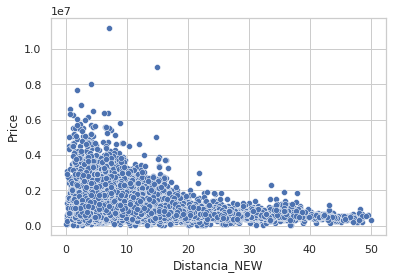

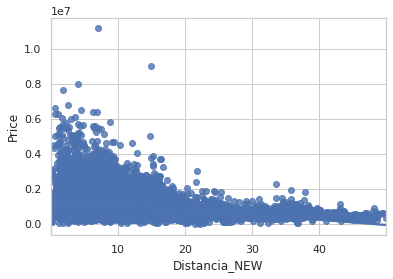

,Rooms,Price,Distance,Postcode,Bathroom,Car,Landsize,Lattitude,Longtitude,Propertycount,Distancia_NEW,BathsAndRooms
count,26838.000000,2.683800e+04,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000
mean,3.097735,1.039176e+06,11.208574,3116.353678,1.619681,1.710932,556.124003,-37.811119,145.002520,7533.416201,12.809045,5.262765
std,0.964138,6.135293e+05,6.760064,111.424187,0.724612,1.000268,2963.598793,0.089491,0.119038,4342.511602,8.041983,61.759218
min,1.000000,1.165300e+04,0.000000,3000.000000,0.000000,0.000000,-104.000000,-38.190430,144.540220,83.000000,0.061816,-2371.446312
25%,3.000000,6.350000e+05,6.400000,3049.000000,1.000000,1.000000,237.000000,-37.863008,144.933900,4407.000000,6.904165,3.380176
50%,3.000000,8.880000e+05,10.300000,3102.000000,2.000000,2.000000,493.000000,-37.807800,145.008000,6763.000000,11.461654,4.320287
75%,4.000000,1.280000e+06,14.000000,3153.750000,2.000000,2.000000,659.000000,-37.754400,145.072000,10331.000000,16.713029,5.886454
max,16.000000,1.120000e+07,47.300000,3978.000000,12.000000,26.000000,433014.000000,-37.395100,145.526350,21650.000000,49.959550,7899.742319


In [208]:

dataframe_jose = pd.read_csv('/home/ruben/tmp/HH_intro_git_ds/precios_casas_sinduplicados.csv')

data_filtered=dataframe_jose[dataframe_jose['Lattitude'].notnull() & \
                       dataframe_jose['Longtitude'].notnull() &\
                       dataframe_jose['Rooms'].notnull() & \
                       dataframe_jose['Bathroom'].notnull() & \
                       dataframe_jose['Price'].notnull()]


print(dataframe_orig)

dataframe_orig=dataframe_orig[dataframe_orig['Lattitude'].notnull() &\
                       dataframe_orig['Longtitude'].notnull() &\
                       dataframe_orig['Rooms'].notnull() & \
                       dataframe_orig['Bathroom'].notnull() & \
                       dataframe_orig['Price'].notnull()]


#Calculamos el precio medio por barrio
data_aux=data_filtered.groupby("Suburb")[["Price"]].mean().reset_index() 
#nos quedamos con el precio medio mas alta
data_aux[data_aux["Price"]==max(data_aux['Price'])]
#cogemos como centro para el calculo de distancia la latitud y longitud media del barrio mas caro
data_frameKoyong=data_filtered[(data_filtered["Suburb"]=='Kooyong')  &  (dataframe["Lattitude"]<-35.0) &
                             (dataframe["Lattitude"]>-39.0) &
                             (dataframe["Longtitude"]<147.0) &
                              (dataframe["Longtitude"]>143.0)]

Koyong_lat_mean=data_frameKoyong["Lattitude"].mean()
Koyong_lon_mean=data_frameKoyong["Longtitude"].mean()
#Calculamos la nueva distancia 
arr=[]
for lat, lon in zip(data_filtered['Lattitude'], data_filtered['Longtitude']):
    arr.append(distance((lat,lon), (Koyong_lat_mean,Koyong_lon_mean)).km)
    print(Koyong_lat_mean,Koyong_lon_mean)
    print(distance((lat,lon), (Koyong_lat_mean,Koyong_lon_mean)).km)

data_filtered["Distancia_NEW"]=arr
#Comprobamos si la correlaciñon mejora y verficamos que casi duplica 
data_filtered=data_filtered[data_filtered["Distancia_NEW"]<50]
sb.scatterplot(data=data_filtered, x="Distancia_NEW", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()

sb.regplot(data=data_filtered, x="Distancia_NEW", y="Price")
plot.show()
data_filtered["BathsAndRooms"]=(data_filtered["Rooms"]+data_filtered["Bathroom"])/data_filtered["Distancia_NEW"].apply(np.log10)



data_filtered.describe()


In [211]:
data_filtered["Price"]=dataframe_orig["Price"]
data_filtered.corr()

data_filtered

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bathroom,Car,Landsize,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount,Distancia_NEW,BathsAndRooms
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,1.0,1.0,126.0,Yarra City Council,-37.80140,144.99580,Northern Metropolitan,4019.0,5.714112,3.963280
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,1.0,1.0,202.0,Yarra City Council,-37.79960,144.99840,Northern Metropolitan,4019.0,5.744380,3.951303
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,1.0,0.0,156.0,Yarra City Council,-37.80790,144.99340,Northern Metropolitan,4019.0,5.298425,4.142807
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,2.0,1.0,0.0,Yarra City Council,-37.81140,145.01160,Northern Metropolitan,4019.0,4.015895,8.281129
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,2.0,0.0,134.0,Yarra City Council,-37.80930,144.99440,Northern Metropolitan,4019.0,5.125216,7.045109
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34851,Yarraville,78 Bayview Rd,3,h,1101000.0,S,Jas,24/02/2018,6.3,3013.0,1.0,1.0,288.0,Maribyrnong City Council,-37.81095,144.88516,Western Metropolitan,6543.0,13.631637,3.525633
34852,Yarraville,13 Burns St,4,h,1480000.0,PI,Jas,24/02/2018,6.3,3013.0,1.0,3.0,593.0,Maribyrnong City Council,-37.81053,144.88467,Western Metropolitan,6543.0,13.685400,4.400411
34853,Yarraville,29A Murray St,2,h,888000.0,SP,Sweeney,24/02/2018,6.3,3013.0,2.0,1.0,98.0,Maribyrnong City Council,-37.81551,144.88826,Western Metropolitan,6543.0,13.243877,3.565014
34854,Yarraville,147A Severn St,2,t,705000.0,S,Jas,24/02/2018,6.3,3013.0,1.0,2.0,220.0,Maribyrnong City Council,-37.82286,144.87856,Western Metropolitan,6543.0,13.925069,2.622842


In [136]:

        

dataframe_filtered=dataframe[(dataframe["Lattitude"]<-36.0) &
                             (dataframe["Lattitude"]>-38.0) &
                             (dataframe["Longtitude"]<146.0) &
                              (dataframe["Longtitude"]>144.0) ]
dataframe_filtered


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bathroom,Car,Landsize,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount,Address_normalized
0,Abbotsford,68 Studley St,2,h,783079.0,SS,Jellis,3/09/2016,2.5,3067.0,1.0,1.0,126.0,Yarra City Council,-37.80140,144.99580,Northern Metropolitan,4019.0,"68 Studley St, City of Melbourne, 3067, Australia"
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,1.0,1.0,202.0,Yarra City Council,-37.79960,144.99840,Northern Metropolitan,4019.0,"85 Turner St, City of Melbourne, 3067, Australia"
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,1.0,0.0,156.0,Yarra City Council,-37.80790,144.99340,Northern Metropolitan,4019.0,"25 Bloomburg St, City of Melbourne, 3067, Aust..."
3,Abbotsford,18/659 Victoria St,3,u,975391.0,VB,Rounds,4/02/2016,2.5,3067.0,2.0,1.0,0.0,Yarra City Council,-37.81140,145.01160,Northern Metropolitan,4019.0,"18/659 Victoria St, City of Melbourne, 3067, A..."
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,2.0,0.0,134.0,Yarra City Council,-37.80930,144.99440,Northern Metropolitan,4019.0,"5 Charles St, City of Melbourne, 3067, Australia"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34851,Yarraville,78 Bayview Rd,3,h,1101000.0,S,Jas,24/02/2018,6.3,3013.0,1.0,1.0,288.0,Maribyrnong City Council,-37.81095,144.88516,Western Metropolitan,6543.0,"78 Bayview Rd, City of Melbourne, 3013, Australia"
34852,Yarraville,13 Burns St,4,h,1480000.0,PI,Jas,24/02/2018,6.3,3013.0,1.0,3.0,593.0,Maribyrnong City Council,-37.81053,144.88467,Western Metropolitan,6543.0,"13 Burns St, City of Melbourne, 3013, Australia"
34853,Yarraville,29A Murray St,2,h,888000.0,SP,Sweeney,24/02/2018,6.3,3013.0,2.0,1.0,98.0,Maribyrnong City Council,-37.81551,144.88826,Western Metropolitan,6543.0,"29A Murray St, City of Melbourne, 3013, Australia"
34854,Yarraville,147A Severn St,2,t,705000.0,S,Jas,24/02/2018,6.3,3013.0,1.0,2.0,220.0,Maribyrnong City Council,-37.82286,144.87856,Western Metropolitan,6543.0,"147A Severn St, City of Melbourne, 3013, Austr..."


In [212]:
data_filtered.to_csv('dataframe-ruben2.csv')
print(data_filtered)





           Suburb             Address  Rooms Type      Price Method  SellerG  \
0      Abbotsford       68 Studley St      2    h        NaN     SS   Jellis   
1      Abbotsford        85 Turner St      2    h  1480000.0      S   Biggin   
2      Abbotsford     25 Bloomburg St      2    h  1035000.0      S   Biggin   
3      Abbotsford  18/659 Victoria St      3    u        NaN     VB   Rounds   
4      Abbotsford        5 Charles St      3    h  1465000.0     SP   Biggin   
...           ...                 ...    ...  ...        ...    ...      ...   
34851  Yarraville       78 Bayview Rd      3    h  1101000.0      S      Jas   
34852  Yarraville         13 Burns St      4    h  1480000.0     PI      Jas   
34853  Yarraville       29A Murray St      2    h   888000.0     SP  Sweeney   
34854  Yarraville      147A Severn St      2    t   705000.0      S      Jas   
34856  Yarraville    3 Tarrengower St      2    h  1020000.0     PI       RW   

             Date  Distance  Postcode  

In [155]:

dataframe_filtered=dataframe[(dataframe["Lattitude"]<-36.0) &
                             (dataframe["Lattitude"]>-38.0) &
                             (dataframe["Longtitude"]<146.0) &
                              (dataframe["Longtitude"]>144.0) ]

dataframe_filtered.describe()

,Rooms,Price,Distance,Postcode,Bathroom,Car,Landsize,Lattitude,Longtitude,Propertycount
count,26318.000000,2.631800e+04,26318.000000,26318.000000,26318.000000,26318.000000,26318.000000,26318.000000,26318.000000,26318.000000
mean,3.092370,1.044965e+06,10.799533,3111.440725,1.617448,1.704575,568.869709,-37.804817,144.998028,7505.400752
std,0.967309,6.167043e+05,6.111890,97.867553,0.724937,1.001198,3180.687286,0.081499,0.117776,4305.521238
min,1.000000,1.165300e+04,0.000000,3000.000000,0.000000,0.000000,-104.000000,-37.999960,144.423790,83.000000
25%,2.000000,6.400000e+05,6.300000,3047.000000,1.000000,1.000000,232.000000,-37.859198,144.931410,4442.000000
50%,3.000000,8.950000e+05,10.100000,3101.000000,2.000000,2.000000,486.000000,-37.805055,145.005400,6567.000000
75%,4.000000,1.290000e+06,13.900000,3150.000000,2.000000,2.000000,656.750000,-37.752700,145.067583,10331.000000
max,16.000000,1.120000e+07,48.100000,3805.000000,12.000000,26.000000,433014.000000,-37.390200,145.526350,21650.000000
